## Processing Ocean Color Imagery

This data was collected in a mapping fashion with a constant viewing geometry of 40 and 135

In [109]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [110]:
import geopandas as gpd
import pandas as pd


import os, glob
import multiprocessing
import math

#import cv2
import numpy as np
import matplotlib.pyplot as plt

#import exiftool
import datetime

import rasterio

from utils import *
from georeg import *

In [3]:
data_dir = os.path.join('data', '20210427_gulf_stream_surveys', 'flight4')
data_dir

'data/20210427_gulf_stream_surveys/flight4'

In [4]:
#grab last 4 characters of the file name:
def last_10chars(x):
    return(x[-10:])

img_fns = glob.glob(data_dir + '/sea' + "/*.tif")

img_fns = sorted(img_fns, key = last_10chars)
len(img_fns)

2868

In [5]:
! ls data/20210427_gulf_stream_surveys/flight4

all_imgs  panel    sea	SYNLog-17-52-25_27-04-2021.csv
chla	  rededge  sky	SYNLog-17-52-25_27-04-2021_edit.csv


In [6]:
data_dir

'data/20210427_gulf_stream_surveys/flight4'

In [7]:
alta_logs = format_alta_logs(data_dir + '/SYNLog-17-52-25_27-04-2021_edit.csv')
alta_logs.head()

/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3347: DtypeWarning: Columns (0,1,2,4,5,6,7,9) have mixed types.Specify dtype option on import or set low_memory=False.
  if (await self.run_code(code, result,  async_=asy)):


,Reading,IMU Time,Date,GPS Time,Unnamed: 4,Longitude,Latitude,GPS Height,GPS Course,GPS Pos N,...,Gyro Bias P,Gyro Bias Y,Accel Bias X,Accel Bias Y,Accel Bias Z,Extended Status,5V Alarm,Z Vibration,Checksum,id
dt,,,,,,,,,,,,,,,,,,,,,
2021-04-27 17:52:25.000000,28,1.074,20210427,17:52:25,NaN,-765495424,344944992,-1.61,7.7,37.9,...,-37.7254,7.1179,0.003,0.015,0.270,0.0,0.0,0.08,105.0,0
2021-04-27 17:52:25.000001,29,1.114,20210427,17:52:25,NaN,-765495424,344944992,-1.61,7.7,37.9,...,-37.7325,7.1181,0.004,0.018,0.270,0.0,0.0,0.08,113.0,1
2021-04-27 17:52:25.000002,30,1.154,20210427,17:52:25,NaN,-765495424,344944992,-1.61,7.7,37.9,...,-37.7378,7.1200,0.004,0.020,0.270,0.0,0.0,0.08,61.0,2
2021-04-27 17:52:25.000003,31,1.194,20210427,17:52:25,NaN,-765495424,344944992,-1.61,7.7,37.9,...,-37.7371,7.1249,0.005,0.023,0.269,0.0,0.0,0.09,214.0,3
2021-04-27 17:52:25.000004,32,1.234,20210427,17:52:25,NaN,-765495424,344944992,-1.61,7.7,37.9,...,-37.7351,7.1254,0.005,0.025,0.269,0.0,0.0,0.09,180.0,4


In [159]:
sky_dir = os.path.join(data_dir, 'sky', 'stacks')
surface_dir = os.path.join(data_dir, 'sea', 'stacks')

In [9]:
51,-18

(51, -18)

In [ ]:
len(mds)

In [11]:
start = 51
count = 30 # 479-51-18
sea_imgs, sea_img_metadata = retrieve_imgs_and_metadata(surface_dir, count=count, start=start, altitude_cutoff=0)

/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/rasterio/__init__.py:218: NotGeoreferencedWarning: Dataset has no geotransform set. The identity matrix may be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


In [13]:
sea_imgs.shape

(30, 6, 1470, 2021)

Find the closest row in the flight logs based on time stamp and add the more accurate yaw

In [12]:
for item in sea_img_metadata:
    utc_time = datetime.datetime.strptime('2021-04-27-' + item['UTC-Time'], '%Y-%m-%d-%H:%M:%S')
    img_idx = alta_logs.index.get_loc(utc_time, method='nearest')
    item['log_id'] = img_idx
    item['alta_yaw'] = (alta_logs.iloc[img_idx]['Yaw'] + 360) % 360
    # then ensures
    item['image_name'] = img_fns[start*6+item['id']*6]

In [160]:
sky_imgs, sky_img_metadata = retrieve_imgs_and_metadata(sky_dir, count=20, start=51, altitude_cutoff=0)

/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/rasterio/__init__.py:218: NotGeoreferencedWarning: Dataset has no geotransform set. The identity matrix may be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


In [163]:
sky_imgs.shape

(20, 6, 1486, 2008)

In [13]:
retrieve_imgs_and_metadata(sky_dir, count=1, start=40, altitude_cutoff=0)[0][0].shape

(6, 1470, 2024)

In [14]:
blocked_dir = os.path.join(data_dir, 'rededge', 'tube', 'stacks')
blocked_dir

'data/20210427_gulf_stream_surveys/flight4/rededge/tube/stacks'

In [15]:
blocked_imgs, blocked_img_metadata = retrieve_imgs_and_metadata(blocked_dir, count=20, start=0, altitude_cutoff=0)

In [13]:
sky_dir_re = os.path.join('data', '20210407_duml_full_workflow_test', 'sky_rededge', 'stacks')
surface_dir_re = os.path.join('data', '20210407_duml_full_workflow_test', 'sea_rededge', 'stacks')

In [14]:
sky_re_imgs, sky_re_img_metadata = retrieve_imgs_and_metadata(sky_dir_re, count=100, start=0, altitude_cutoff=0)
sea_re_imgs, sea_re_img_metadata = retrieve_imgs_and_metadata(surface_dir_re, count=100, start=0, altitude_cutoff=0)

Output shape is:  (4, 5, 946, 1267)
Output shape is:  (9, 5, 946, 1267)


only grab metadata

Open the md of each image and then sort by time and then I know the order of pitch

then I can sort by pitch and yaw

In [16]:
band_names = ['blue', 'green', 'red', 'red edge', 'nir']

In [89]:
mds = load_img_fn_and_meta(surface_dir, start=0)
len(mds)

479

In [14]:
for md in mds:
    if md['filename'] == '378vNa6UAi8CshsGKO4m.tif':
        print(md['UTC-Time'])

14:55:37


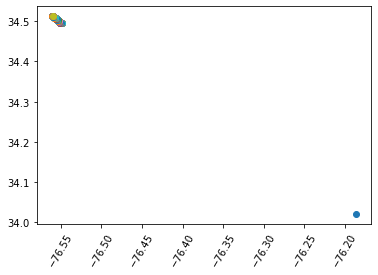

In [13]:
for md in mds:
    plt.scatter(md['Longitude'],md['Latitude'])
    plt.xticks(rotation=60)

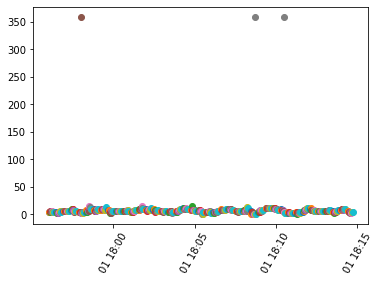

In [24]:
for md in mds[51:-18]:
    plt.scatter(datetime.datetime.strptime(md['UTC-Time'], '%H:%M:%S'), md['yaw'])
    plt.xticks(rotation=60)

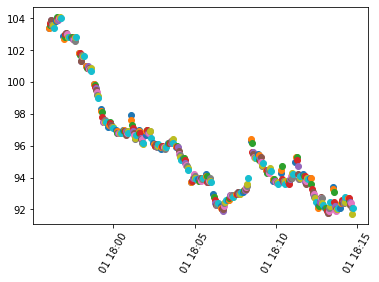

In [23]:
for md in mds[51:-18]:
    plt.scatter(datetime.datetime.strptime(md['UTC-Time'], '%H:%M:%S'), md['Altitude'])
    plt.xticks(rotation=60)

In [38]:
from datetime import datetime
chla_dates = []
for im in sea_img_metadata:
    date_time_str = im['Date'] + ' ' + im['UTC-Time']

    date_time_obj = datetime.strptime(date_time_str, '%m/%d/%Y %H:%M:%S')
    chla_dates.append(date_time_obj)

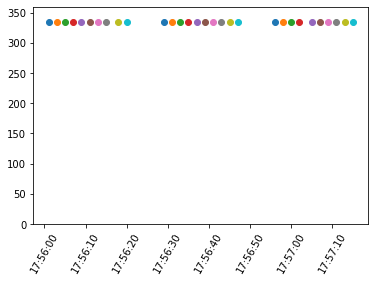

In [17]:
import datetime

for md in sea_img_metadata:
    plt.scatter(datetime.datetime.strptime(md['UTC-Time'], '%H:%M:%S'), md['alta_yaw'])
    plt.xticks(rotation=60)
    plt.ylim(0,360)

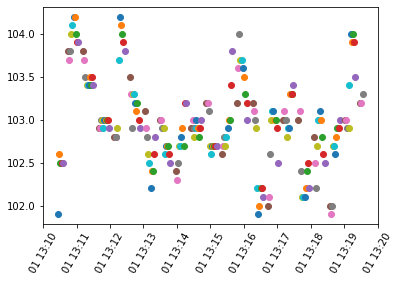

In [24]:
import datetime

for md in mds[84:]:
    plt.scatter(datetime.datetime.strptime(md['UTC-Time'], '%H:%M:%S'), md['Altitude'])
    plt.xticks(rotation=60)

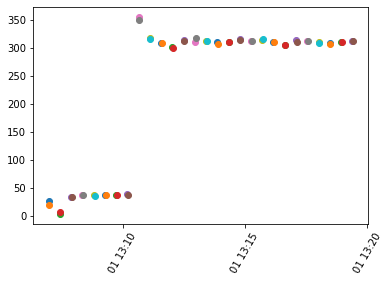

In [13]:
for md in mds:
    plt.scatter(datetime.datetime.strptime(md['UTC-Time'], '%H:%M:%S'), md['pitch'])
    plt.xticks(rotation=60)

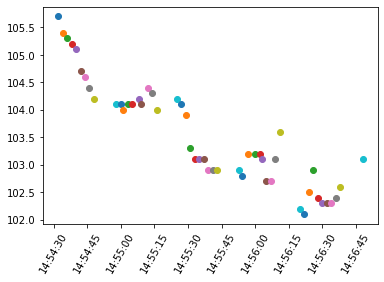

In [42]:
for md in sea_img_metadata:
    plt.scatter(datetime.datetime.strptime(md['UTC-Time'], '%H:%M:%S'), md['Altitude'])
    plt.xticks(rotation=60)

In [17]:
sea_imgs.nbytes / 1e9

8.5561056

In [18]:
sky_imgs.nbytes / 1e9

2.1422016

Inspect a couple images

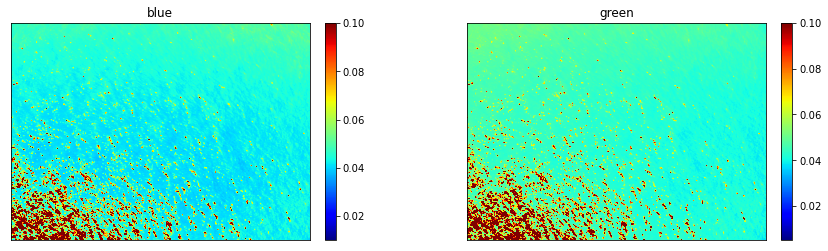

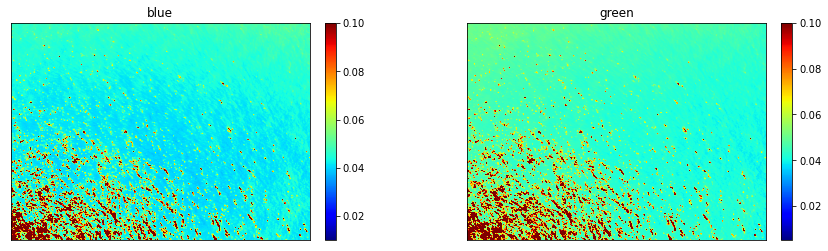

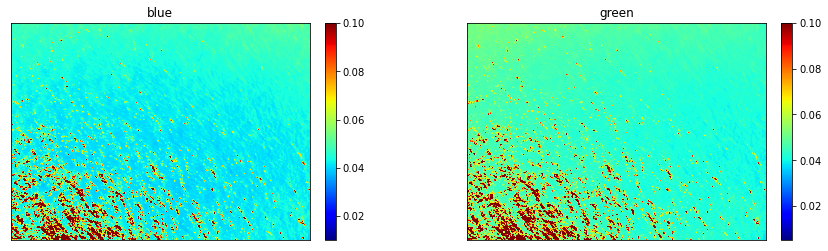

In [18]:
for i in [5,15,25]:
    fig, ax = plt.subplots(1,2, figsize=(15,4))
    im = ax[0].imshow(sea_imgs[i,0],cmap='jet', vmin=0.01, vmax=.1)
    fig.colorbar(im, ax=ax[0], fraction=0.046, pad=0.04)
    ax[0].set_xticks([])
    ax[0].set_yticks([])
    ax[0].set_title('blue')
    
    im = ax[1].imshow(sea_imgs[i,1],cmap='jet', vmin=0.005, vmax=.1)
    fig.colorbar(im, ax=ax[1], fraction=0.046, pad=0.04)
    ax[1].set_xticks([])
    ax[1].set_yticks([])
    ax[1].set_title('green')
    plt.show()

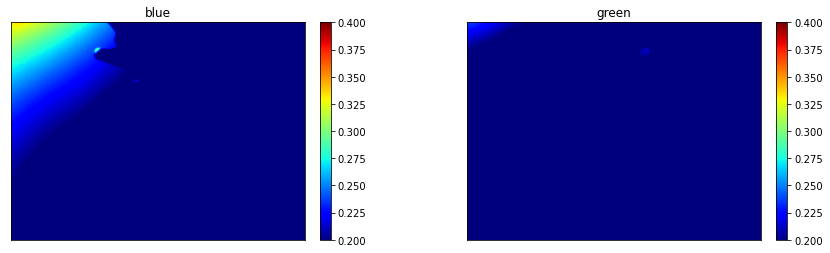

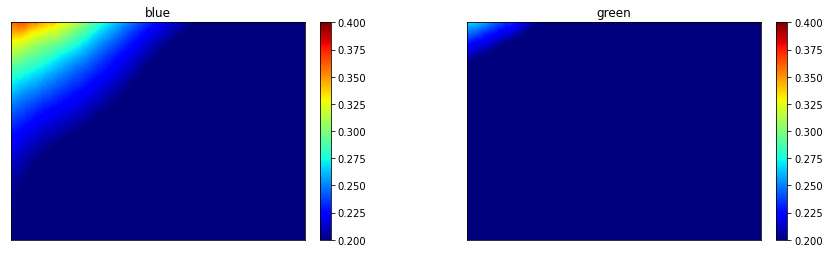

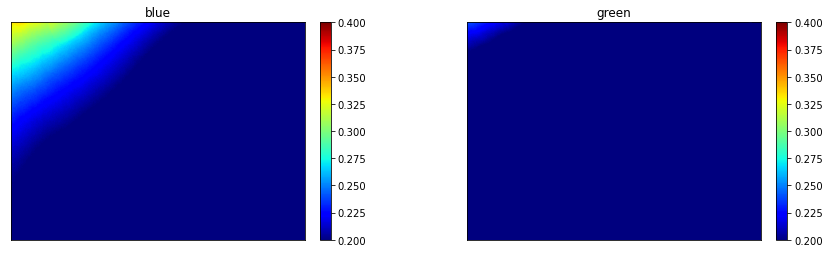

In [166]:
for i in [1,10,15]:
    fig, ax = plt.subplots(1,2, figsize=(15,4))
    im = ax[0].imshow(sky_imgs[i,0],cmap='jet', vmin=0.2, vmax=.4)
    fig.colorbar(im, ax=ax[0], fraction=0.046, pad=0.04)
    ax[0].set_xticks([])
    ax[0].set_yticks([])
    ax[0].set_title('blue')
    
    im = ax[1].imshow(sky_imgs[i,1],cmap='jet', vmin=0.2, vmax=.4)
    fig.colorbar(im, ax=ax[1], fraction=0.046, pad=0.04)
    ax[1].set_xticks([])
    ax[1].set_yticks([])
    ax[1].set_title('green')
    plt.show()

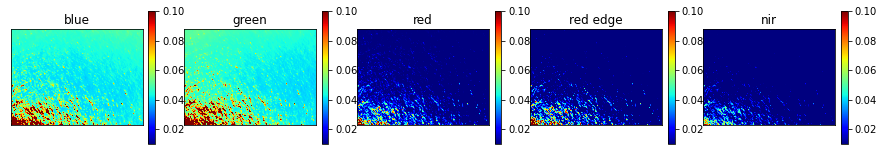

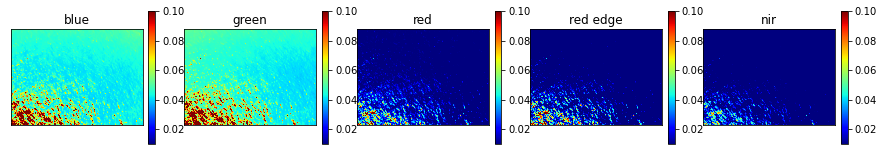

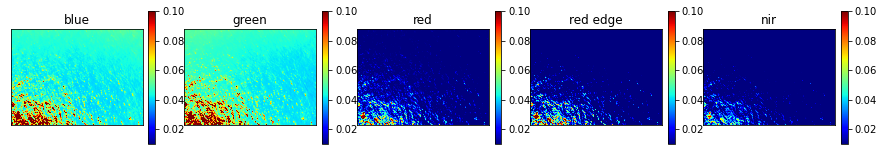

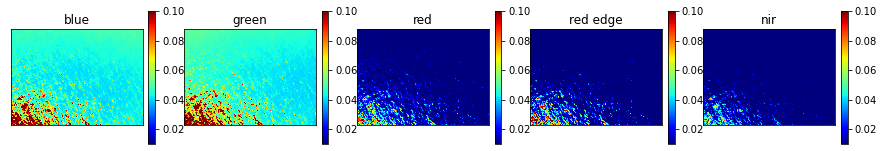

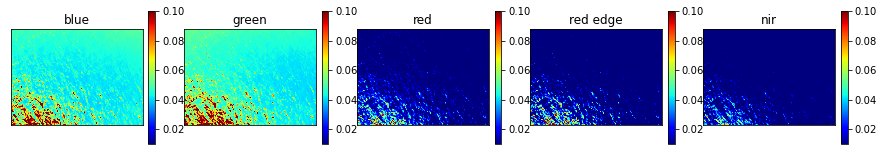

In [19]:
for j in range(21,26):
    fig, ax = plt.subplots(1,5, figsize=(15,4))
    for i in range(5):
        im = ax[i].imshow(sea_imgs[j,i],cmap='jet', vmin=0.01, vmax=.1)
        fig.colorbar(im, ax=ax[i], fraction=0.046, pad=0.04)
        ax[i].set_xticks([])
        ax[i].set_yticks([])
        ax[i].set_title(band_names[i])

Visualize some stacked RGB images

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


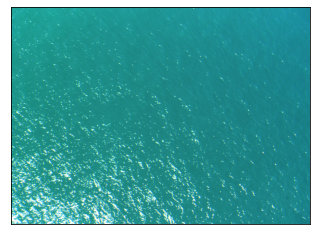

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


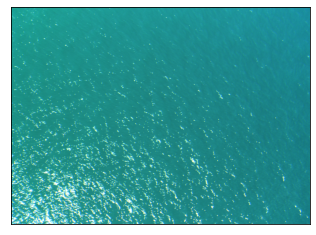

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


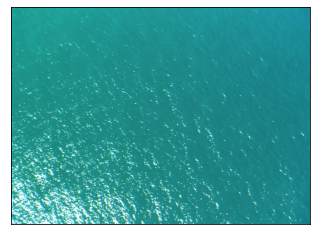

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


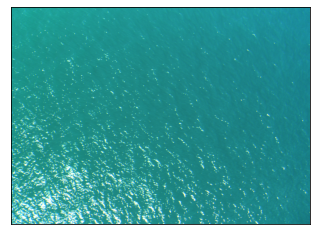

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


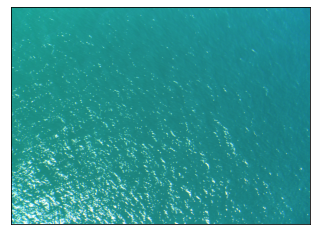

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


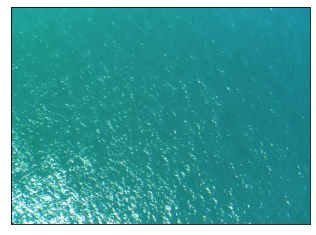

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


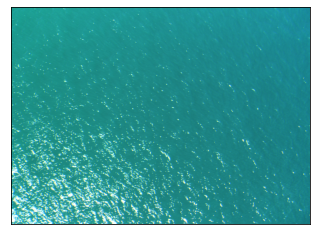

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


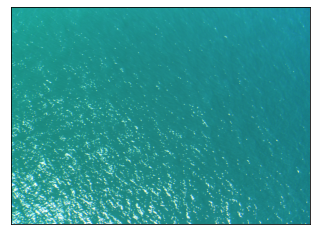

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


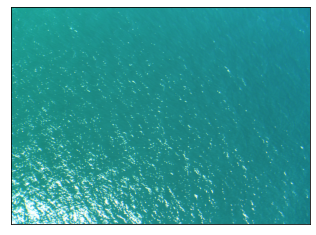

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


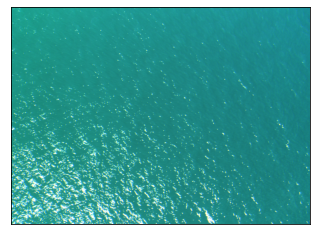

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


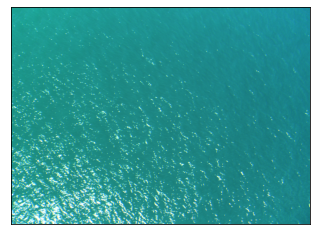

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


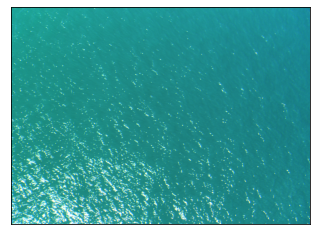

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


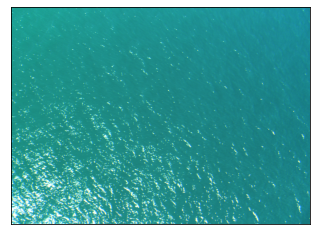

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


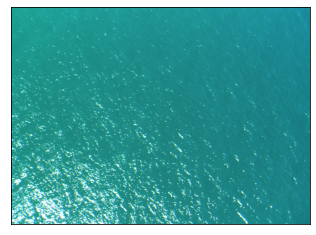

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


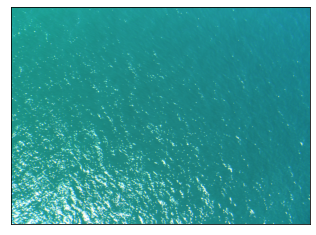

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


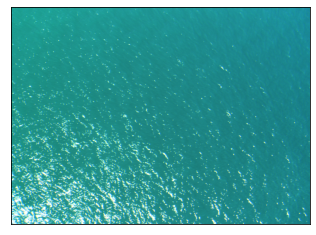

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


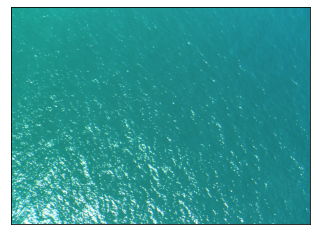

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


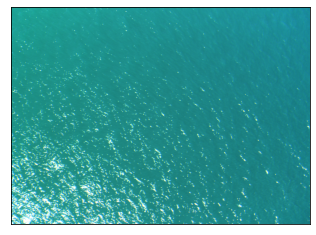

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


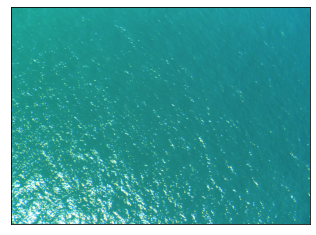

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


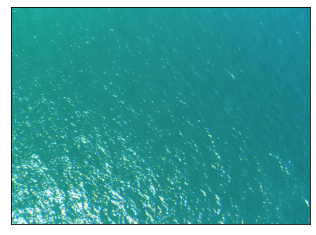

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


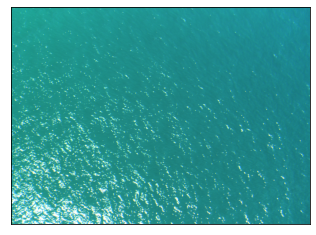

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


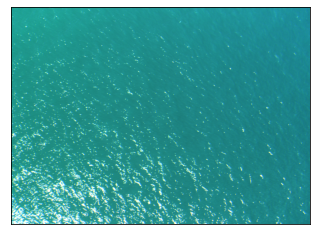

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


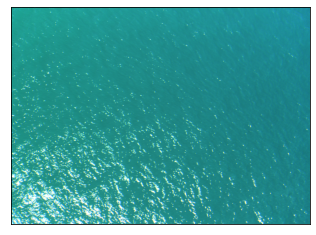

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


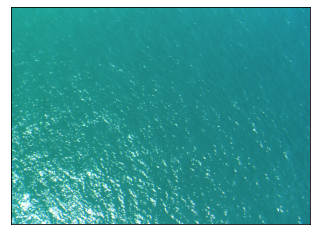

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


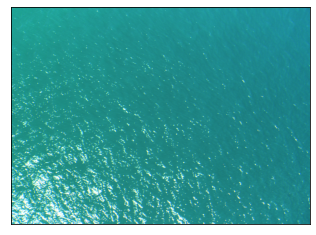

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


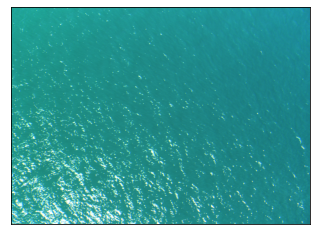

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


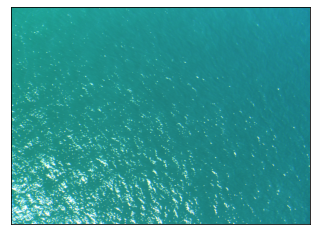

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


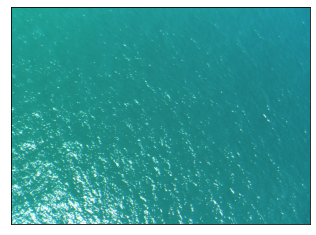

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


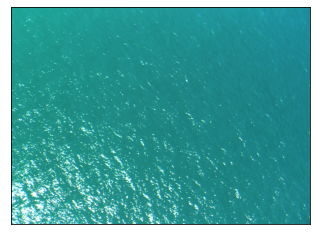

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


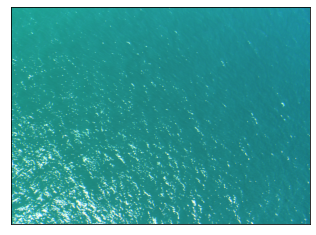

In [24]:
for j in range(0,30):
    plt.imshow((np.transpose(sea_imgs[j,0:3]/0.08, (1,2,0))[:,:,::-1]))
    plt.xticks([])
    plt.yticks([])
    plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


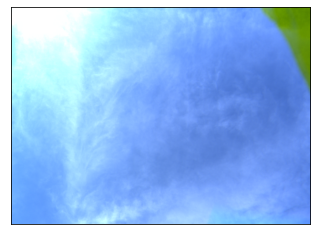

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


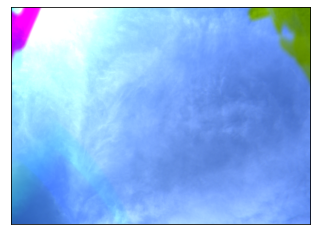

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


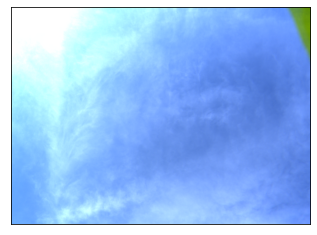

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


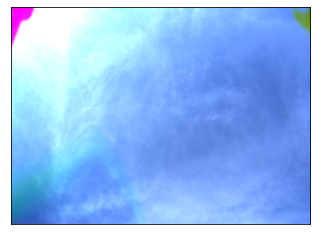

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


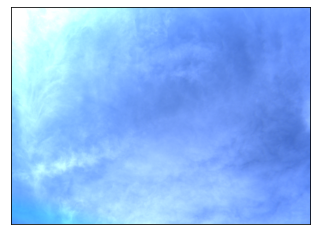

In [23]:
for j in range(0,5):
    plt.imshow((np.transpose(sky_imgs[j,0:3]/0.3, (1,2,0))[:,:,::-1]))
    plt.xticks([])
    plt.yticks([])
    plt.show()

### create medians of each image for correction

In [25]:
sea_imgs.shape

(30, 6, 1470, 2021)

In [168]:
sky_imgs.shape

(20, 6, 1486, 2008)

In [26]:
sea_median = np.median(sea_imgs, axis=0)

In [167]:
sky_median = np.median(sky_imgs, axis=0)

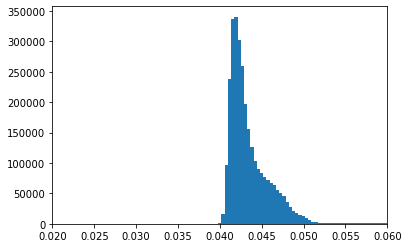

In [30]:
plt.hist(sea_median[0].flatten(), bins=300)
plt.xlim(0.02,0.06)
plt.show()

In [31]:
np.median(sea_median, axis=(1,2))

array([0.04270935, 0.04402161, 0.00935364, 0.0040741 , 0.00177002,
       0.88014221])

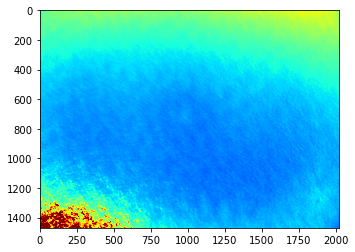

In [33]:
plt.imshow(sea_median[0], vmin=0.035,vmax=.06, cmap='jet')

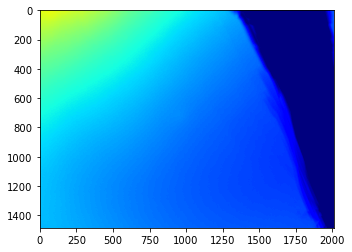

In [169]:
plt.imshow(sky_median[0], vmin=0.04,vmax=.55, cmap='jet')

#### inspect the sun blocked spectra based on the brightest pics there

In [35]:
blocked_imgs.shape

(20, 5, 945, 1266)

brightest pixels used: 1196
brightest pixels used: 1196
brightest pixels used: 1196
brightest pixels used: 1196
brightest pixels used: 1196
brightest pixels used: 1196
brightest pixels used: 1196
brightest pixels used: 1196
brightest pixels used: 1196
brightest pixels used: 1196
brightest pixels used: 1196
brightest pixels used: 1196
brightest pixels used: 1196
brightest pixels used: 1196
brightest pixels used: 1196
brightest pixels used: 1196
brightest pixels used: 1196
brightest pixels used: 1196
brightest pixels used: 1196
brightest pixels used: 1196


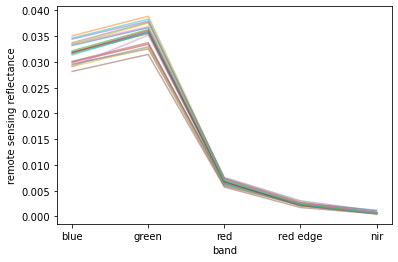

In [36]:
blocked_spectra = []
for i in range(0,blocked_imgs.shape[0]):
    spec = brightest_tube_pix(blocked_imgs[i], percent=0.001)
    plt.plot(band_names, spec, alpha=0.5)
    plt.ylabel('remote sensing reflectance')
    plt.xlabel('band')
    blocked_spectra.append(spec)
blocked_spectra = np.array(blocked_spectra)

In [28]:
0.03035012 / 0.00595001

5.100851931341292

In [61]:
0.020176/0.00536137

3.7632172373852204

In [37]:
median_blocked_spec = np.median(blocked_spectra,axis=0)
median_blocked_spec

array([0.03178648, 0.03576335, 0.00672131, 0.0023665 , 0.00068477])

In [38]:
median_blocked_spec[0]/median_blocked_spec[1]

0.8888004968662252

In [40]:
ci1 = -0.49
ci2 = 191.6590

# ci1 = -0.38152295986028695
# ci2 = 271.37634868

# average of 443*.5 + 489*1.5
# ci1 = -0.30002281538304754
# ci2 = 310.5772338

# ci1 = -0.21380600002416383
# ci2 = 572.01573044



def oc_index(blue, green, red):
    blue, green, red = blue/math.pi, green/math.pi, red/math.pi
    CI = green - ( blue + (555 - 477)/(667 - 477) * (red - blue) )
    
    #print(green)
    #print(( blue + (555 - 443)/(667 - 443) * (red - blue) ))
    
    #print(CI)

    ChlCI = 10**(ci1 + ci2*CI)
    return(ChlCI)

In [42]:
vec_chla_img(median_blocked_spec[0],median_blocked_spec[1])

1.9736810572350938

In [43]:
print('chla is: ', oc_index(median_blocked_spec[0],median_blocked_spec[1], median_blocked_spec[2]))

chla is:  2.400893330356661


Run through each image, subtract the blocked spectra, then find the average spectra, then run chla algorithm on it, then add it to list

### Correct for sun glint

### This is the current approach to calculating rho based on sunblocked spectra

Simple version

Take the blocked spectra and subtract that from Lt and then smooth that over and that is the correction to all the other images

Sea median - blocked_spectra is lsky * rho. So then to get Lw in the future all I need to do is subtract that from Lt

In [44]:
smoothed_lt_lw = ndimage.gaussian_filter(((sea_median[:5,:,:].T - np.median(blocked_spectra, axis=0)).T), sigma=(0, 10, 10), order=0)

Visualize the sea median bands

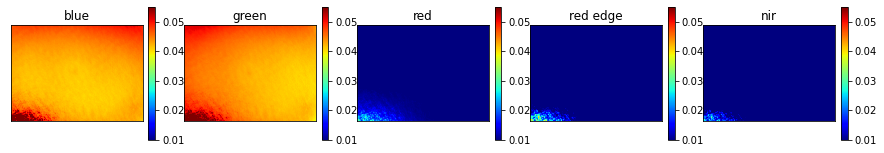

In [45]:
fig, ax = plt.subplots(1,5, figsize=(15,4))
for i in range(5):
    im = ax[i].imshow(sea_median[i],cmap='jet', vmin=0.01, vmax=.055)
    fig.colorbar(im, ax=ax[i], fraction=0.046, pad=0.04)
    ax[i].set_xticks([])
    ax[i].set_yticks([])
    ax[i].set_title(band_names[i])

Sea median images divided by image mean

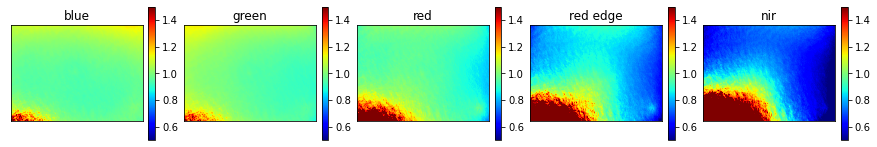

In [46]:
fig, ax = plt.subplots(1,5, figsize=(15,4))
for i in range(5):
    im = ax[i].imshow(sea_median[i]/np.mean(sea_median[i]),cmap='jet', vmin=0.5, vmax=1.5)
    fig.colorbar(im, ax=ax[i], fraction=0.046, pad=0.04)
    ax[i].set_xticks([])
    ax[i].set_yticks([])
    ax[i].set_title(band_names[i])

Sky median images

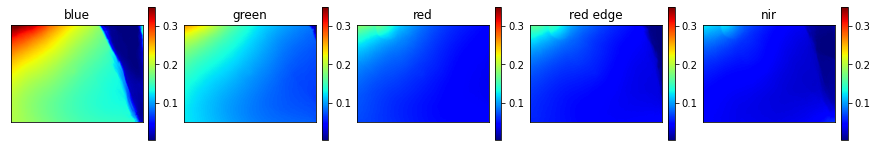

In [170]:
fig, ax = plt.subplots(1,5, figsize=(15,4))
for i in range(5):
    im = ax[i].imshow(sky_median[i],cmap='jet', vmin=0.003, vmax=.35)
    fig.colorbar(im, ax=ax[i], fraction=0.046, pad=0.04)
    ax[i].set_xticks([])
    ax[i].set_yticks([])
    ax[i].set_title(band_names[i])

Sky median divided by the mean sky median

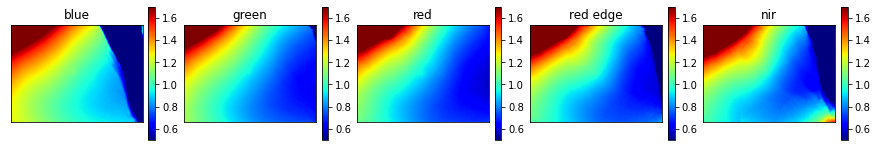

In [171]:
fig, ax = plt.subplots(1,5, figsize=(15,4))
for i in range(5):
    im = ax[i].imshow(sky_median[i]/np.mean(sky_median[i]),cmap='jet', vmin=.5, vmax=1.7)
    fig.colorbar(im, ax=ax[i], fraction=0.046, pad=0.04)
    ax[i].set_xticks([])
    ax[i].set_yticks([])
    ax[i].set_title(band_names[i])

Smoothed lt - lw images (aka rho*lsky)

***This is what will be subtracted from each image

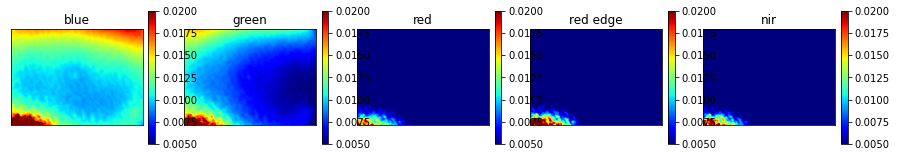

In [47]:
fig, ax = plt.subplots(1,5, figsize=(15,4))
for i in range(5):
    im = ax[i].imshow(smoothed_lt_lw[i],cmap='jet', vmin=0.005, vmax=.02)
    fig.colorbar(im, ax=ax[i], fraction=0.046, pad=0.04)
    ax[i].set_xticks([])
    ax[i].set_yticks([])
    ax[i].set_title(band_names[i])

lt - lw divided buy the mean of that

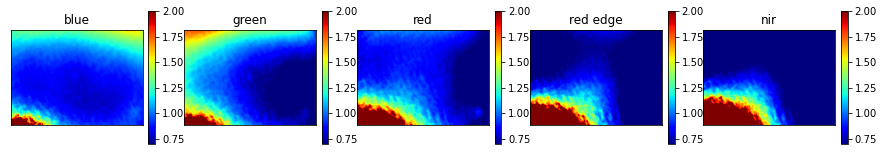

In [48]:
fig, ax = plt.subplots(1,5, figsize=(15,4))
for i in range(5):
    im = ax[i].imshow(smoothed_lt_lw[i]/np.mean(smoothed_lt_lw[i]),cmap='jet', vmin=.7, vmax=2)
    fig.colorbar(im, ax=ax[i], fraction=0.046, pad=0.04)
    ax[i].set_xticks([])
    ax[i].set_yticks([])
    ax[i].set_title(band_names[i])

lt-lw divided by lsky which is effectively rho

NameError: name 'sky_median' is not defined

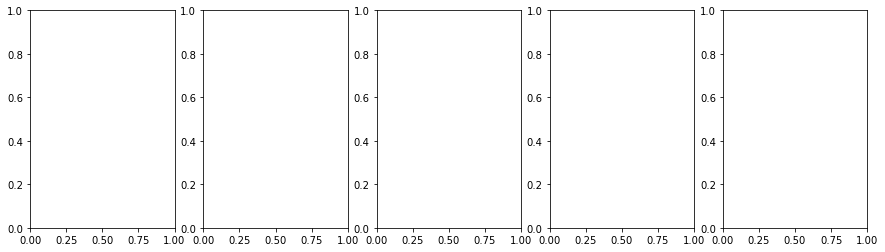

In [81]:
fig, ax = plt.subplots(1,5, figsize=(15,4))
for i in range(5):
    im = ax[i].imshow(smoothed_lt_lw[i]/sky_median[i,::-1,:2021],cmap='jet', vmin=0.001, vmax=.2)
    fig.colorbar(im, ax=ax[i], fraction=0.046, pad=0.04)
    ax[i].set_xticks([])
    ax[i].set_yticks([])
    ax[i].set_title(band_names[i])

### Apply simple approach

just take smoothed_lt_lw and subtract it from the lt images

First look at all bands

In [50]:
1

1

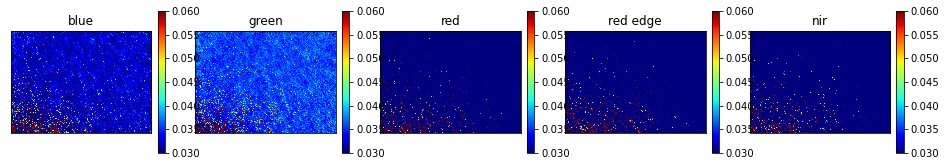

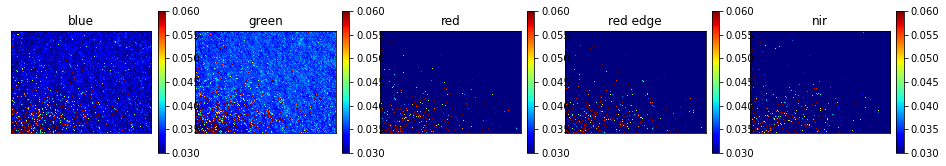

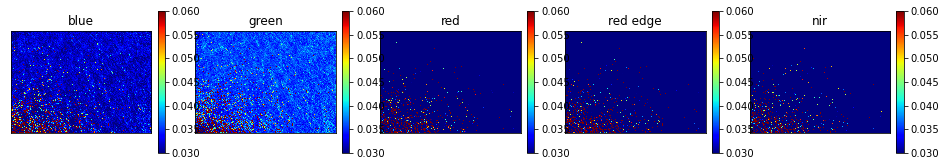

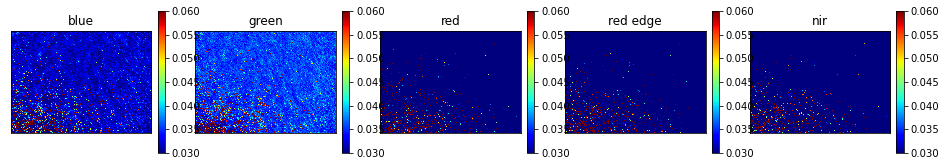

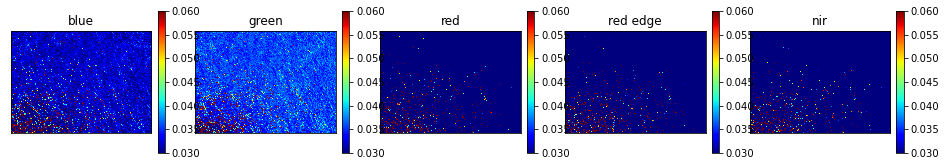

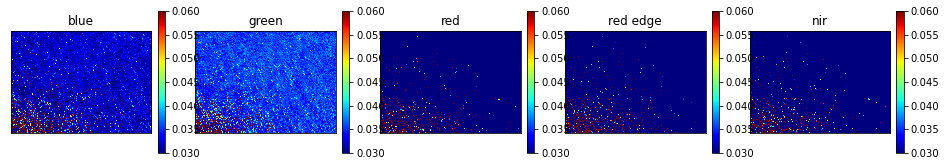

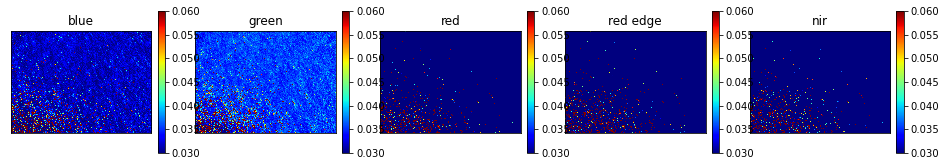

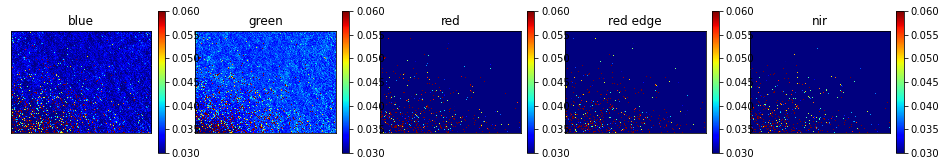

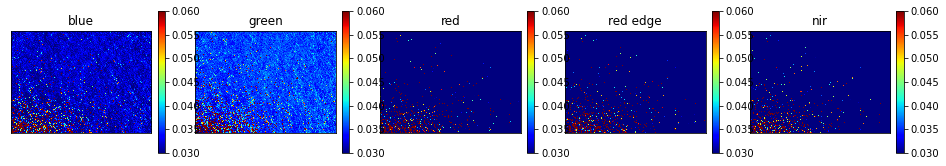

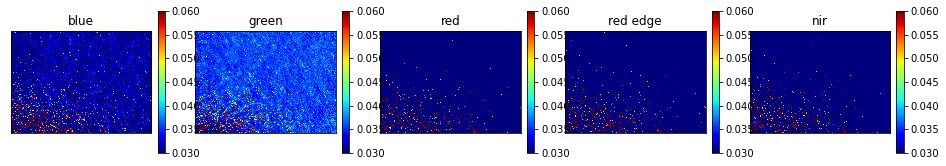

In [51]:
for i in range(0,30):
    visualize_darkest_pixels(sea_imgs[i,:5] - smoothed_lt_lw, lowest_percent=1, max_clim=0.060, min_clim=0.03, only_img=True)

Now let's look at before and after with blue and green bands

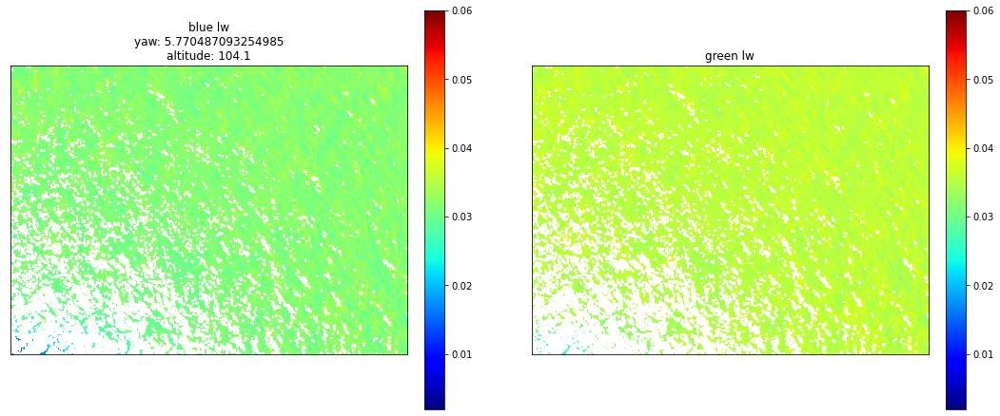

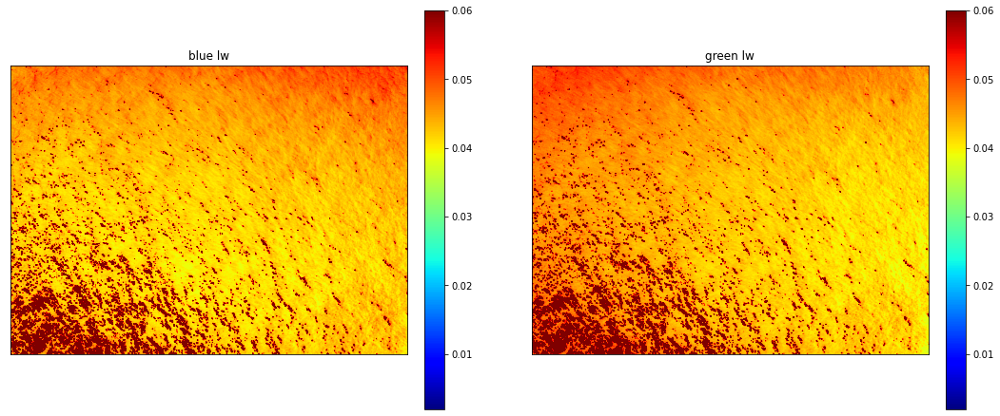

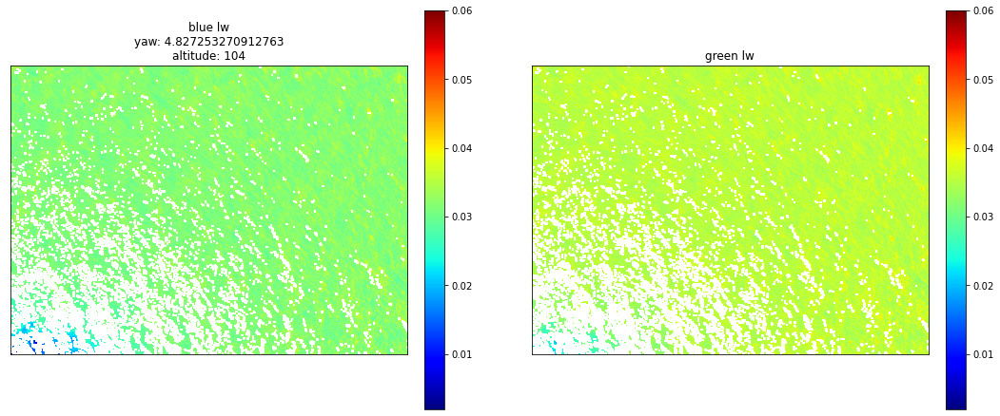

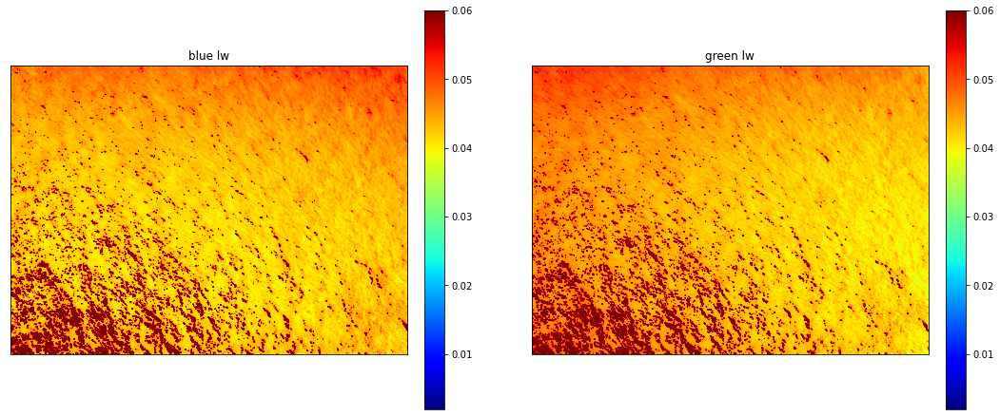

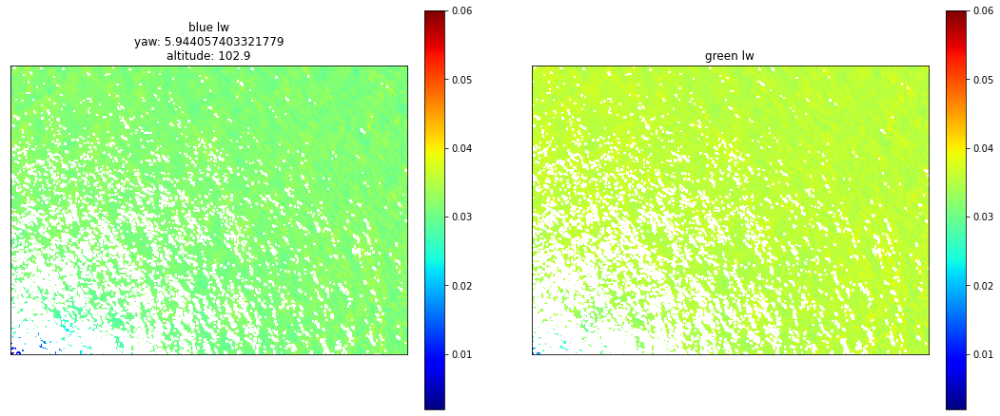

...

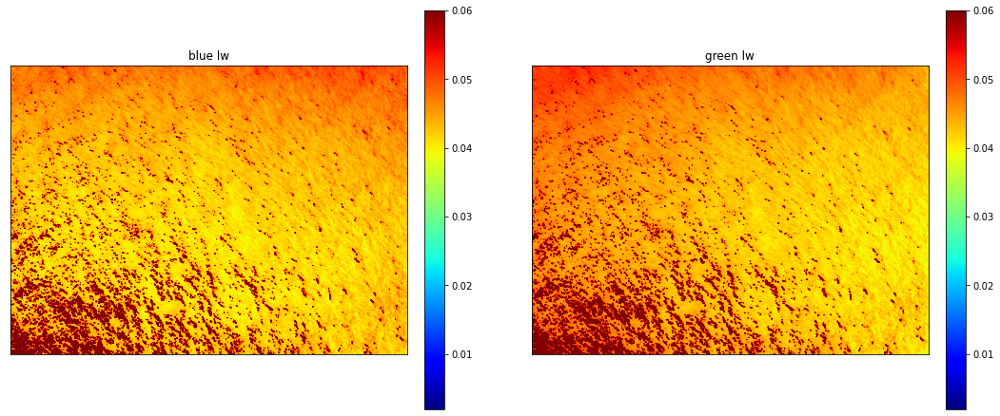

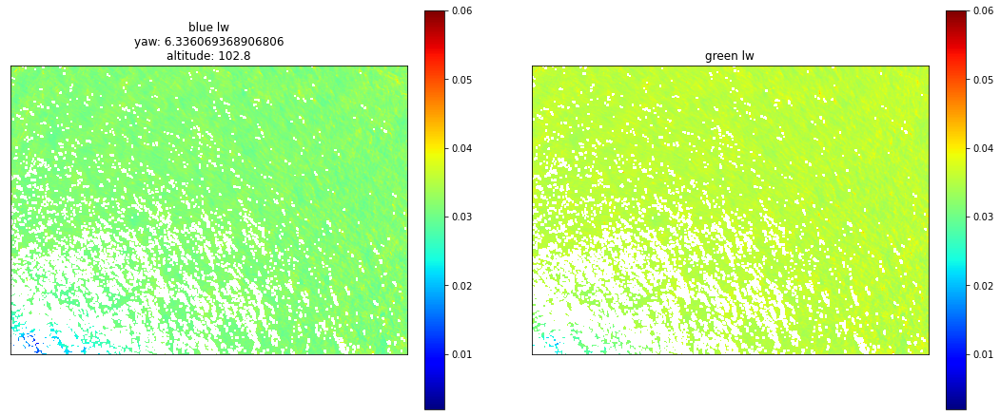

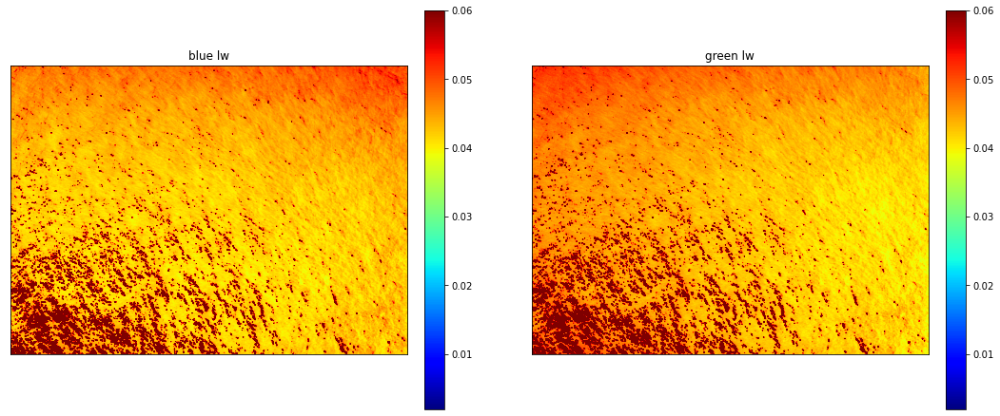

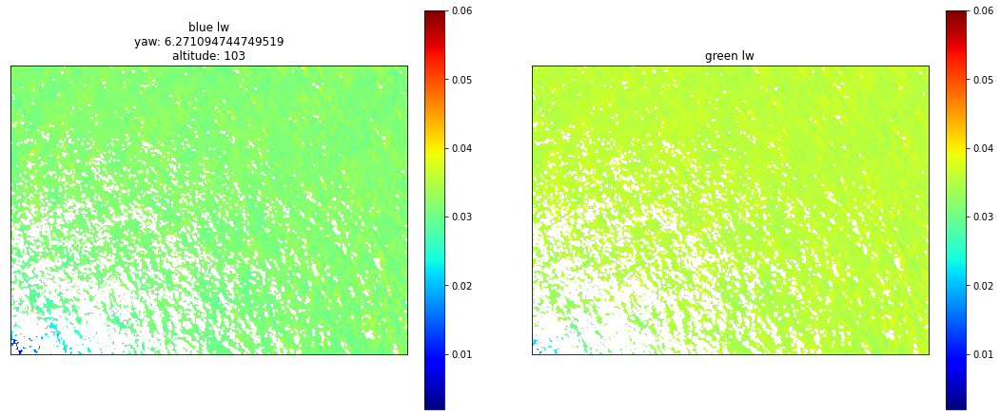

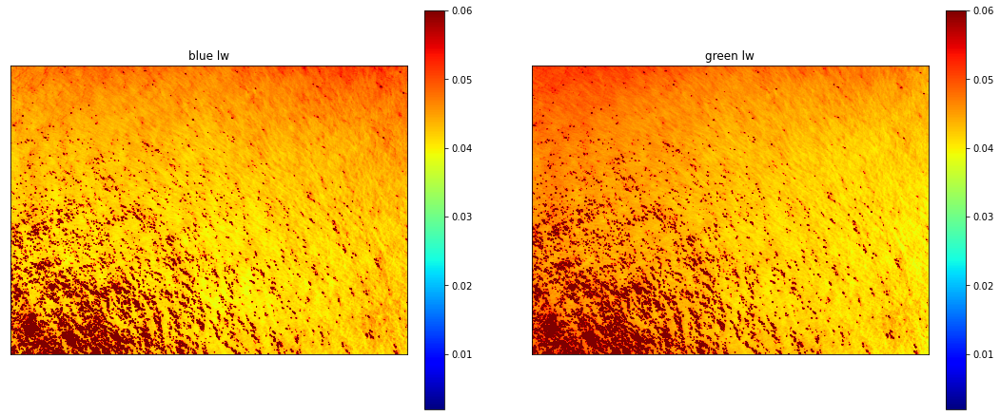

In [52]:
for i in range(18,24):
    fig, ax = plt.subplots(1,2, figsize=(18,8))
    img = sea_imgs[i,:5] - smoothed_lt_lw
    
    img[img > 0.055] = np.nan
    
    
    im = ax[0].imshow(img[0],cmap='jet', vmin=0.002, vmax=.06)
    fig.colorbar(im, ax=ax[0], fraction=0.046, pad=0.04)
    ax[0].set_xticks([])
    ax[0].set_yticks([])
    ax[0].set_title('blue lw\nyaw: ' + str(sea_img_metadata[i]['yaw']) + '\naltitude: ' + str(sea_img_metadata[i]['Altitude']))
    im = ax[1].imshow(img[1],cmap='jet', vmin=0.002, vmax=.06)
    fig.colorbar(im, ax=ax[1], fraction=0.046, pad=0.04)
    ax[1].set_xticks([])
    ax[1].set_yticks([])
    ax[1].set_title('green lw')
    plt.show()
    
    fig, ax = plt.subplots(1,2, figsize=(18,8))
    
    im = ax[0].imshow(sea_imgs[i,0],cmap='jet', vmin=0.002, vmax=.06)
    fig.colorbar(im, ax=ax[0], fraction=0.046, pad=0.04)
    ax[0].set_xticks([])
    ax[0].set_yticks([])
    ax[0].set_title('blue lw')
    im = ax[1].imshow(sea_imgs[i, 1],cmap='jet', vmin=0.002, vmax=.06)
    fig.colorbar(im, ax=ax[1], fraction=0.046, pad=0.04)
    ax[1].set_xticks([])
    ax[1].set_yticks([])
    ax[1].set_title('green lw')
    plt.show()

#### Inspect the spectra from this

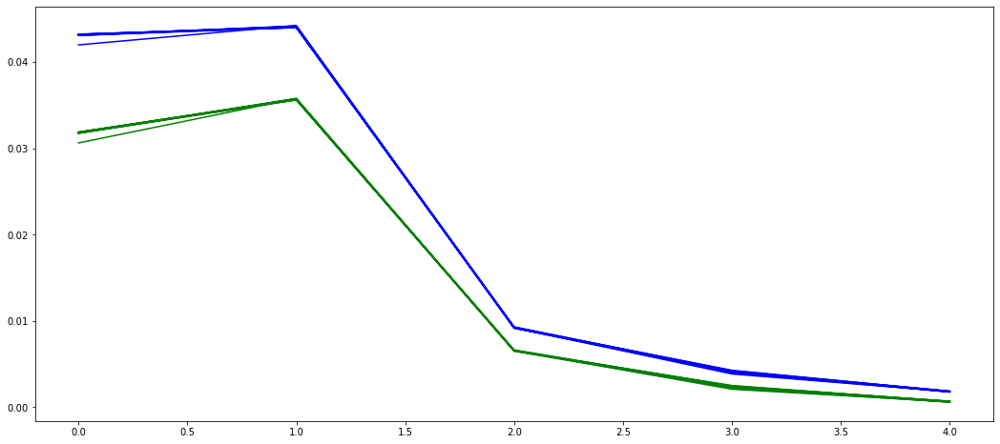

In [53]:
fig, ax = plt.subplots(figsize=(18,8))

for i in range(0,15):
    img = sea_imgs[i,:5] - smoothed_lt_lw
    
#    img[img > 0.055] = np.nan
    
    ax.plot(np.nanmedian(img,axis=(1,2)), color='green')
    ax.plot(np.nanmedian(sea_imgs[i,:5],axis=(1,2)), color='blue')

In [58]:
img = sea_imgs[5,:5].copy() - smoothed_lt_lw
img[np.repeat((img[2] > 0.085)[np.newaxis,:,:],5,axis=0)] = np.nan
    
#chla_oci = oc_index(img[0], img[1], img[2])

chla_oci = vec_chla_img(img[0], img[1])

In [59]:
np.nanmean(img, axis=(1,2))

array([0.03603818, 0.03794476, 0.00767908, 0.00477114, 0.00240398])

In [60]:
chla_oci[chla_oci > 10] = 10

In [61]:
np.nanmean(chla_oci)

2.130794028298719

In [62]:
np.nanmedian(chla_oci)

1.9481237081866036

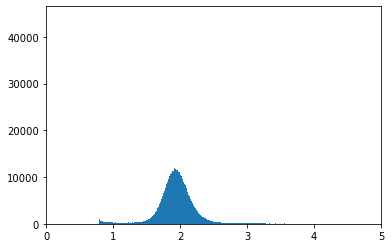

In [63]:
plt.hist(chla_oci.flatten(),  bins=5000)
plt.xlim(0,5)
plt.show()

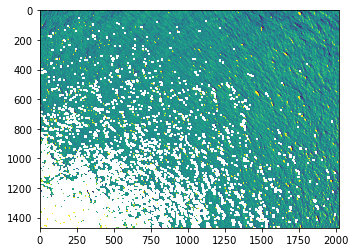

In [65]:
plt.imshow(chla_oci, vmin=np.nanmedian(chla_oci)-0.5, vmax=np.nanmedian(chla_oci)+0.5)

In [66]:
sea_imgs.shape

(30, 6, 1470, 2021)

oc index median is:
2.388872140634173


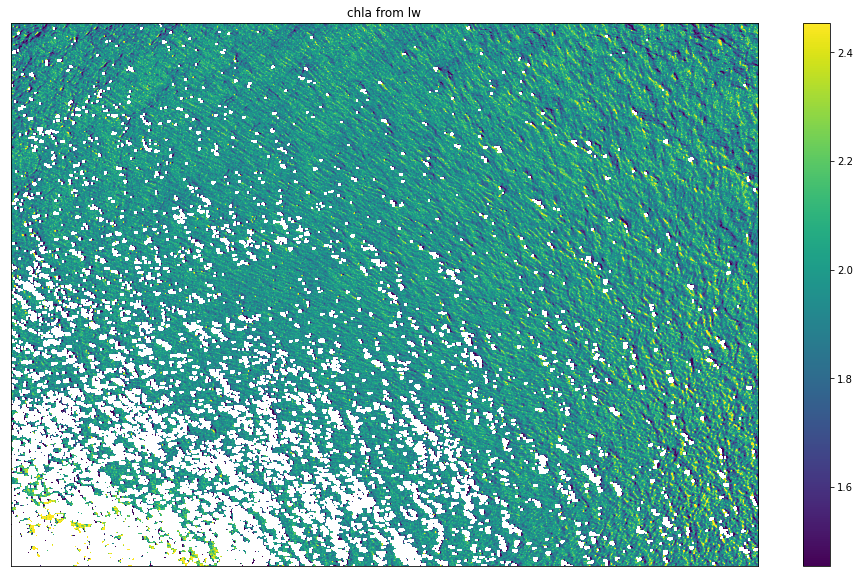

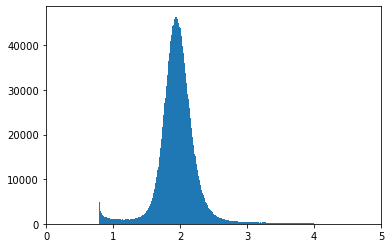

In [72]:
for i in range(0,30):
    fig, ax = plt.subplots(1, figsize=(20,10))
    img = sea_imgs[i,:5].copy() - smoothed_lt_lw
    img[np.repeat((img[1] > 0.15)[np.newaxis,:,:],5,axis=0)] = np.nan
        
    #chla_lw = vec_chla_img(img[0], img[1])
    #chla_lw = chla_lw[:500,:-1600]
    #img = img[:,:500,:-1600]    
    
    #chla_oci = oc_index(img[0], img[1], img[2])
    chla_oci = vec_chla_img(img[0], img[1])
    chla_oci[chla_oci<0] = 0
    chla_oci[chla_oci>4] = np.nan
    
    img_median = np.nanmedian(img, axis=(1,2))
    print('oc index median is:')
    print(oc_index(img_median[0], img_median[1], img_median[2]))
    
    #print(vec_chla_img(img_median[0], img_median[1]))
    #print(np.nanmedian(chla_lw))
    im = ax.imshow(chla_oci,cmap='viridis', vmin=np.nanmedian(chla_oci)-.5, vmax=np.nanmedian(chla_oci)+.5)
    fig.colorbar(im, ax=ax, fraction=0.046, pad=0.04)
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_title('chla from lw')
    plt.show()
    
    plt.hist(chla_oci.flatten(), bins=500)
    plt.xlim(0,5)
    plt.show()
    break

What does this look like slightly blurred?

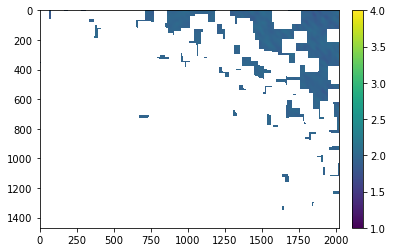

In [77]:
fig,ax = plt.subplots()
im = ax.imshow(ndimage.gaussian_filter(chla_oci, sigma=(9, 9), order=0), cmap='viridis', vmin=1, vmax=3.5)
fig.colorbar(im, ax=ax, fraction=0.046, pad=0.04)

Fill gaps just to see whole image

In [78]:
# TODO this is not the *ideal* solution
mask = np.isnan(chla_oci)
idx = np.where(~mask,np.arange(mask.shape[1]),0)
np.maximum.accumulate(idx,axis=1, out=idx)
out = chla_oci[np.arange(idx.shape[0])[:,None], idx]

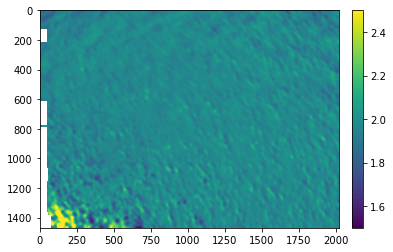

In [84]:
fig,ax = plt.subplots()
im = ax.imshow(ndimage.gaussian_filter(out, sigma=(9, 9), order=0), cmap='viridis', vmin=1.5, vmax=2.5)
fig.colorbar(im, ax=ax, fraction=0.046, pad=0.04)

##### Inspect the data geographically

Turn each image to a point and put it into a gdf

In [85]:
img = retrieve_imgs_and_metadata(surface_dir, count=1, start=95, altitude_cutoff=0)[0]
sst = img[0,5]

/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/rasterio/__init__.py:218: NotGeoreferencedWarning: Dataset has no geotransform set. The identity matrix may be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


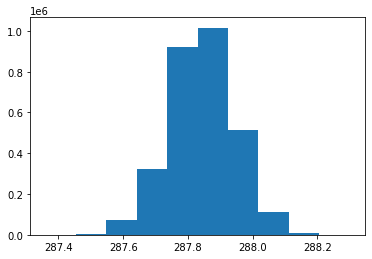

In [86]:
plt.hist((sst* 32768 / 100).flatten())
plt.show()

(0.0, 4.0)

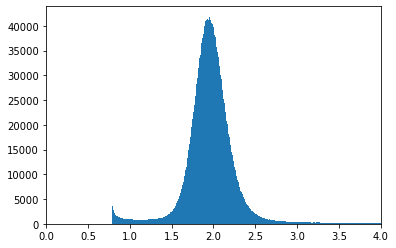

In [137]:
plt.hist(lw_img[1].flatten(), bins=1000)
plt.xlim(0,0.1)

In [107]:
%matplotlib inline

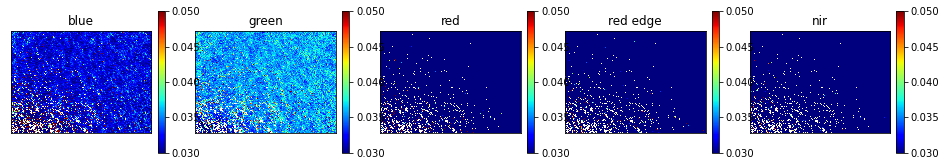

1.956620032561019


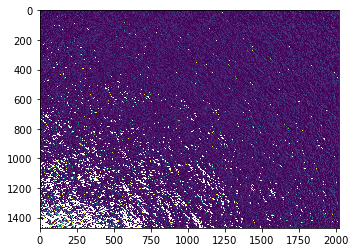

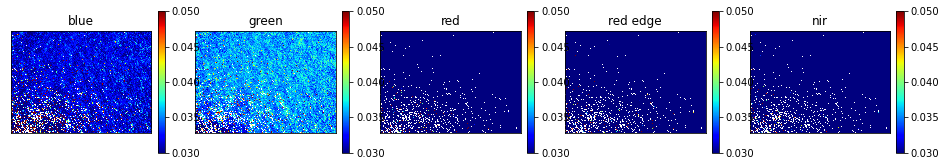

1.9564037429532344


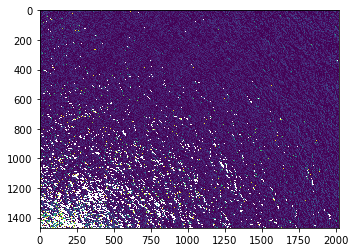

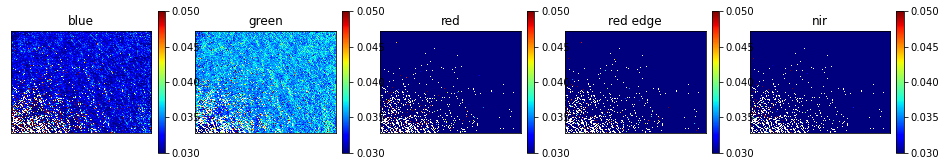

1.9550851682677368


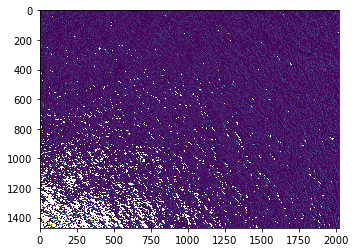

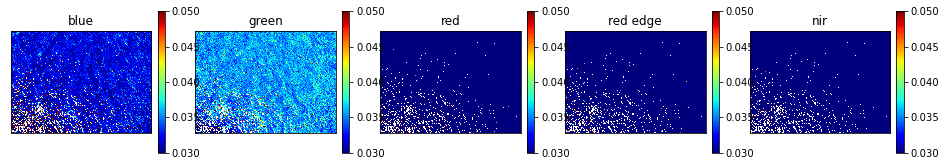

1.9465264378378797


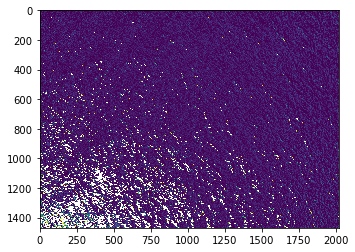

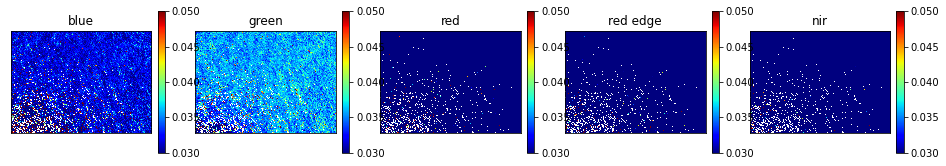

1.9553337508039006


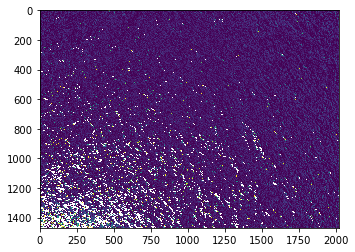

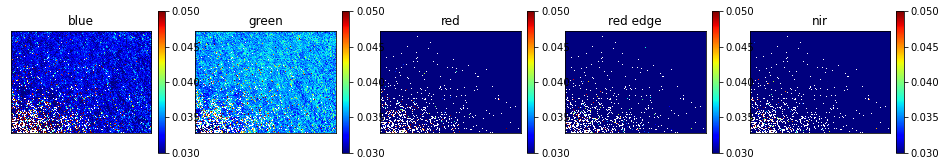

1.942876944089916


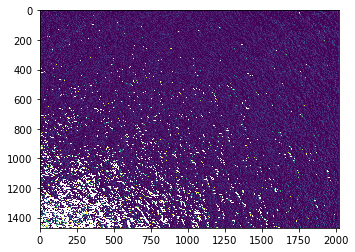

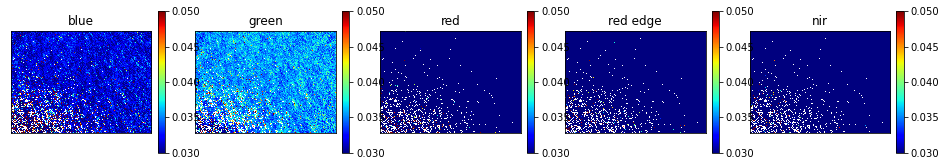

1.9568844389425752


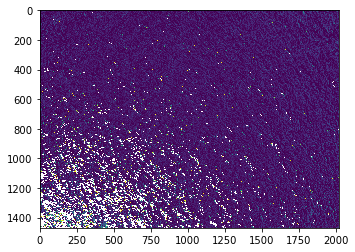

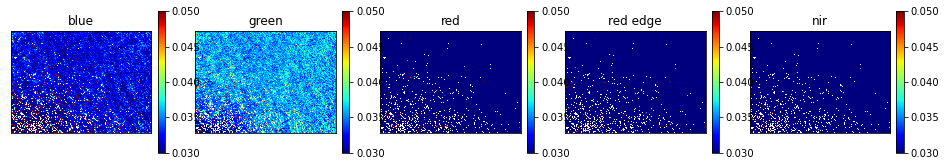

1.9572277147245782
10th image


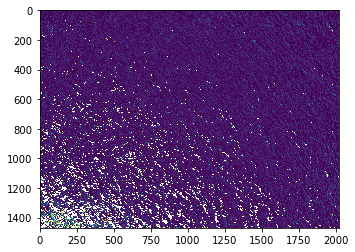

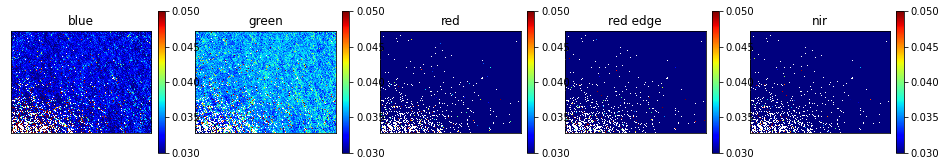

1.9542822112695357


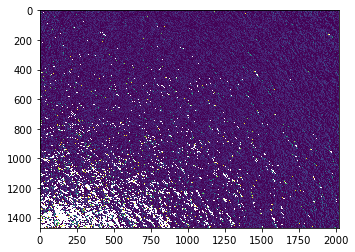

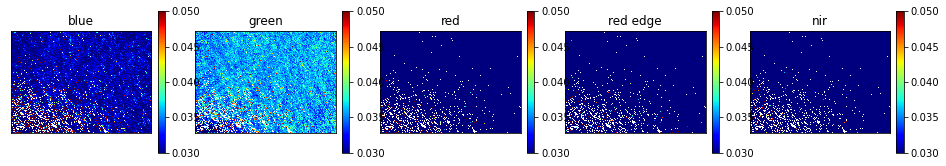

2.128791752389195


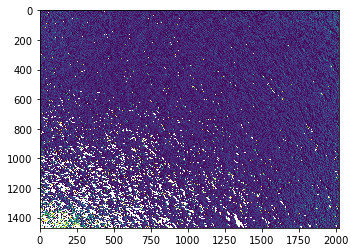

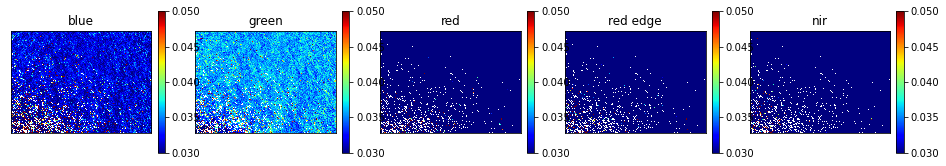

1.974474258975796


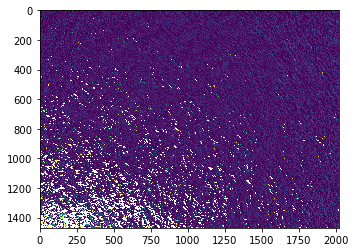

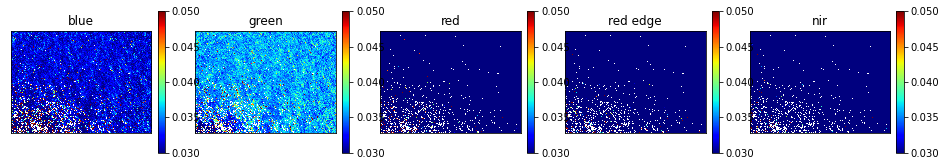

1.9748470484885763


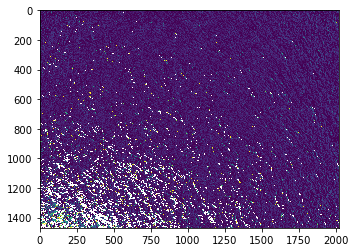

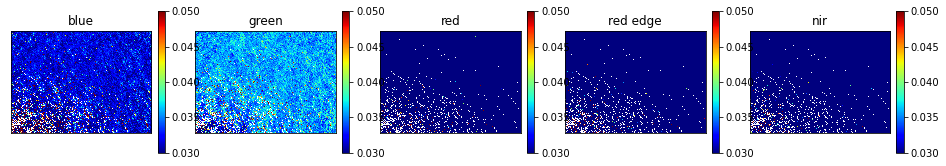

1.9751534068356702


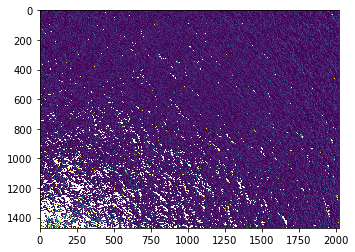

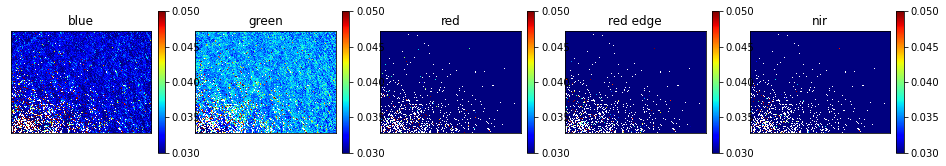

1.964718619013978


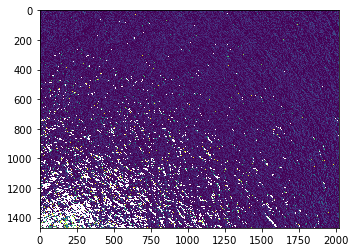

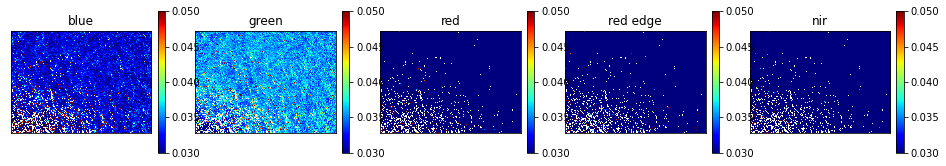

1.965874184503623


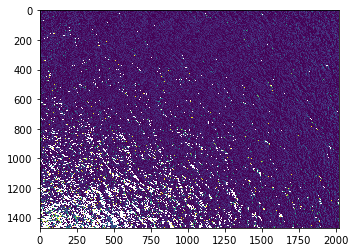

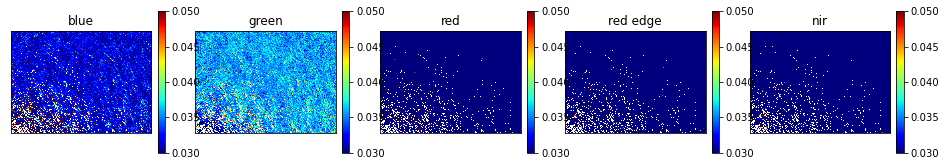

1.975588613539971


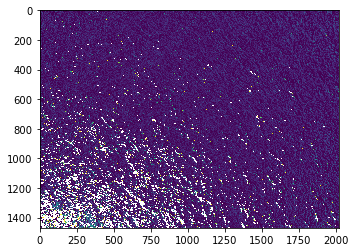

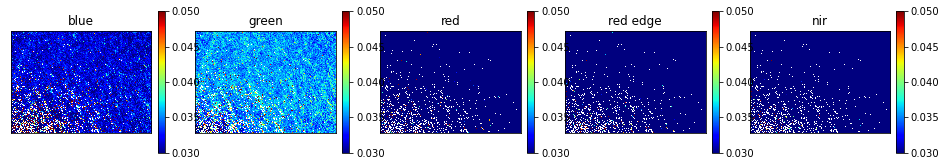

1.9637498766605606


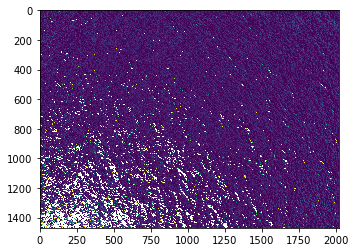

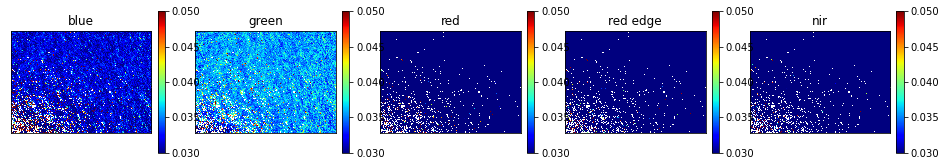

1.9724854098554412
10th image


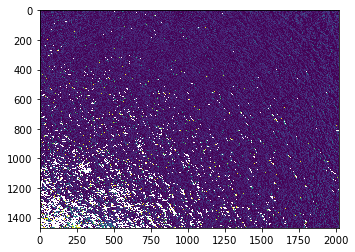

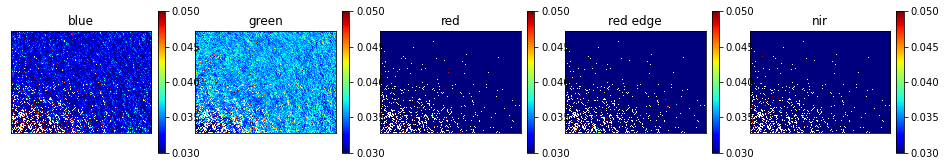

1.971304293620828


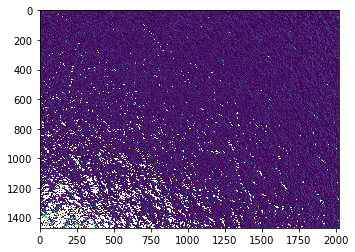

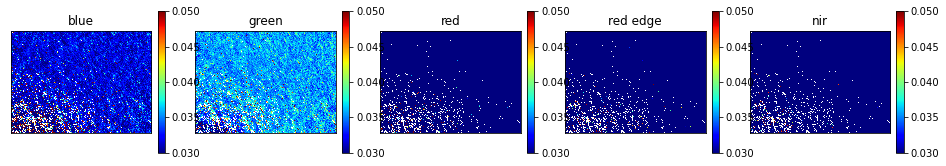

1.9571651054239112


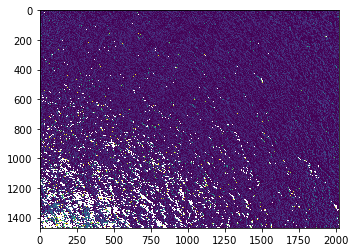

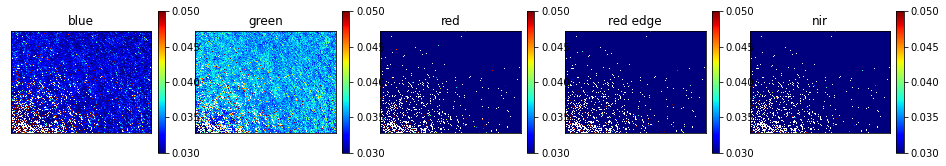

1.9854761285612725


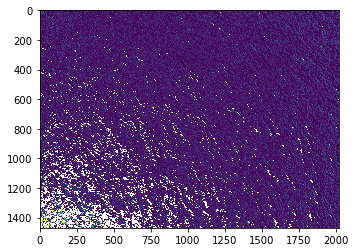

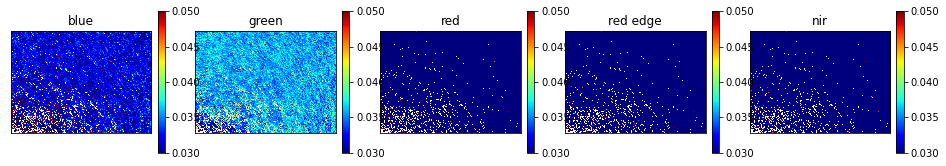

1.9859277344960833


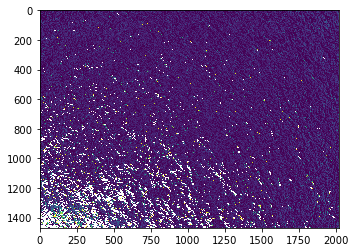

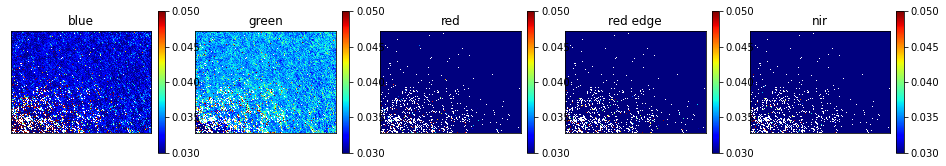

1.974632717256252


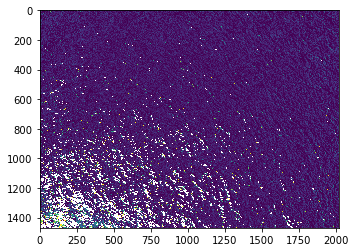

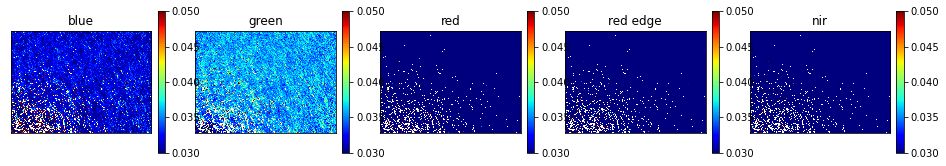

1.9732739328135318


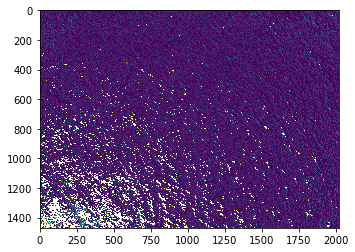

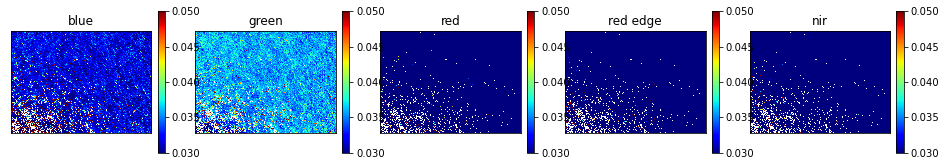

1.9709413439467176


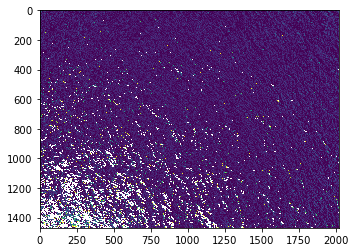

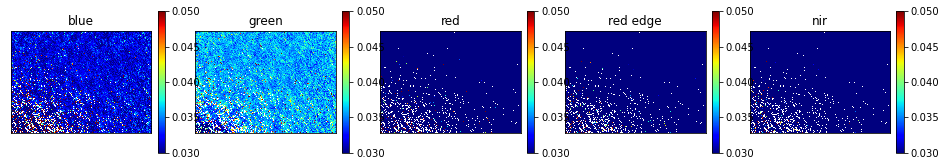

1.9836706695851762


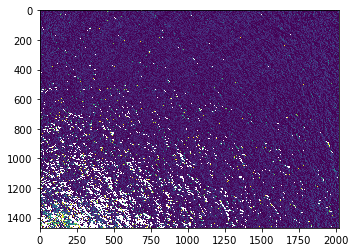

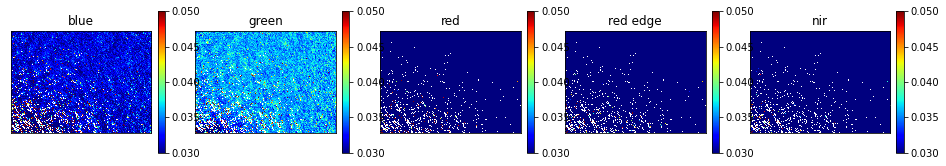

1.9832994149761216


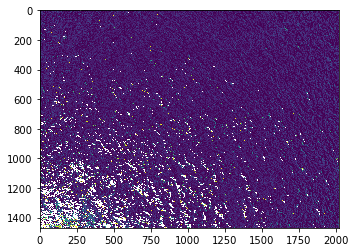

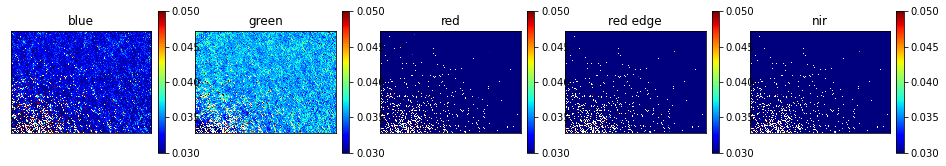

1.9799318702961588
10th image


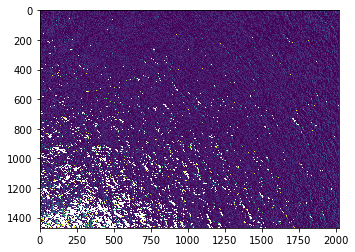

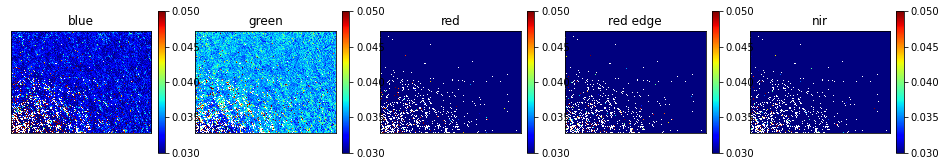

1.9794796311909875


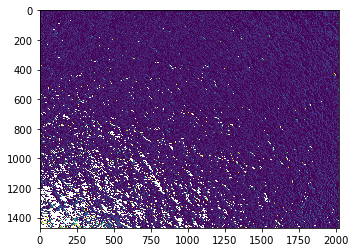

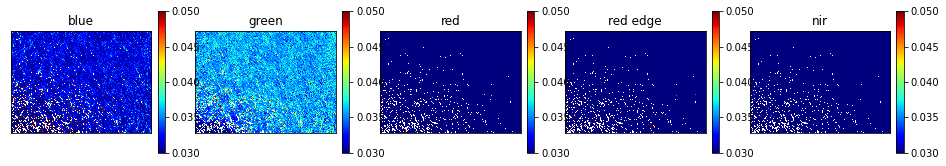

1.9723598092201828


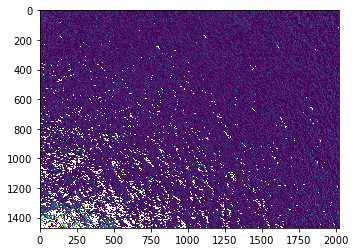

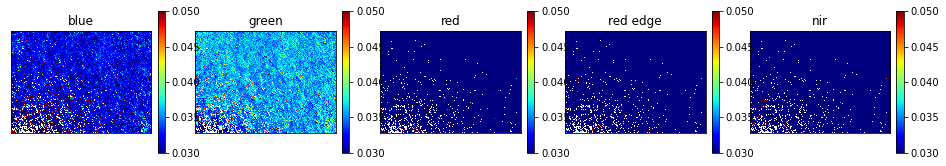

1.966139592590438


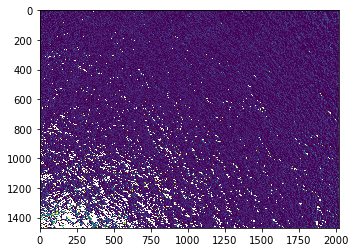

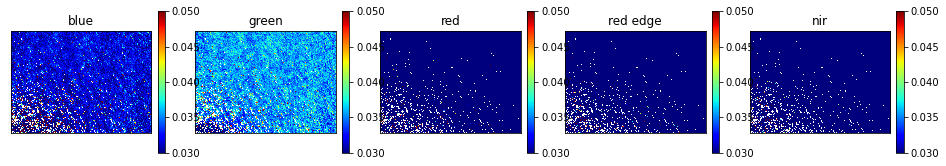

1.9668185243222198


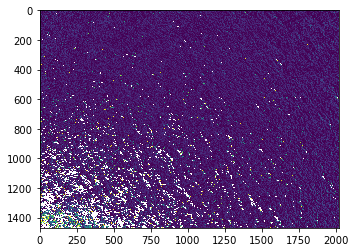

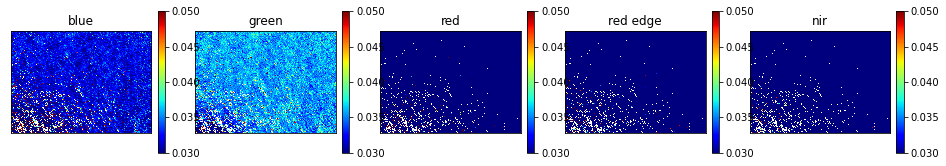

1.9555330858285005


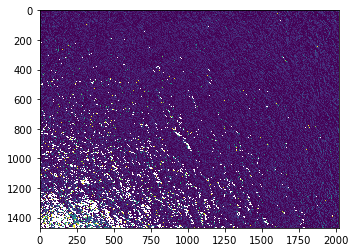

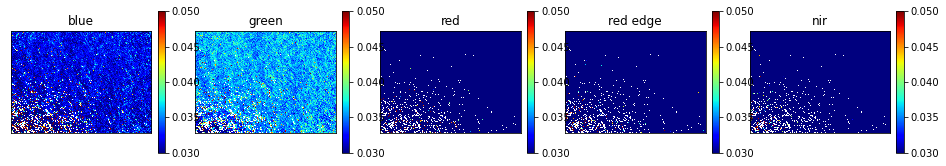

1.9618504201629476


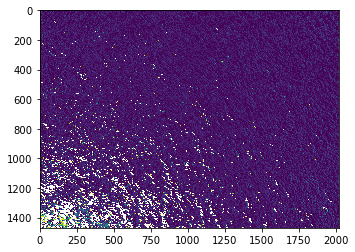

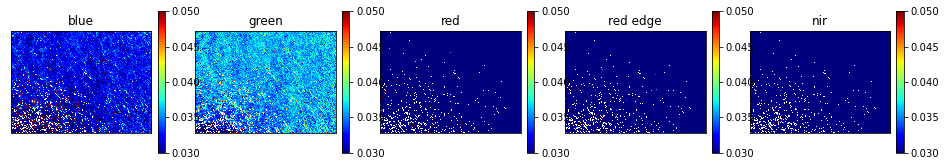

1.9514202740375794


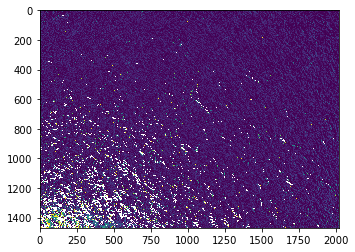

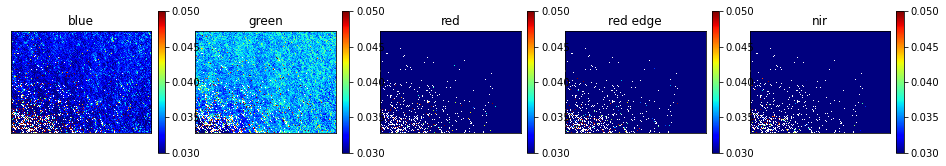

1.958983215475082


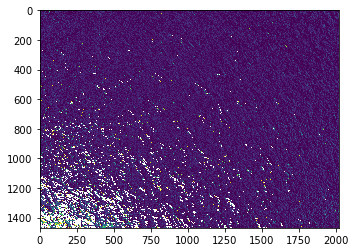

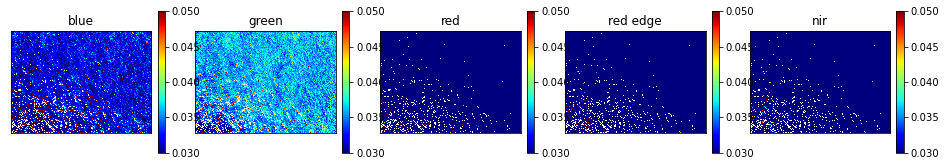

1.9736412134718668


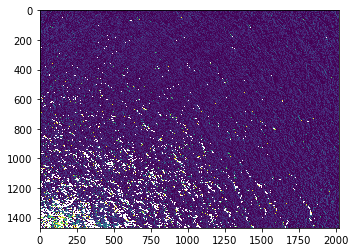

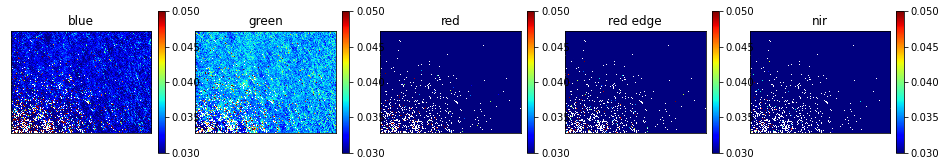

1.9675191801893908
10th image


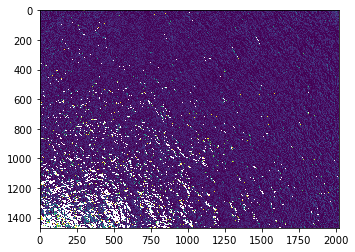

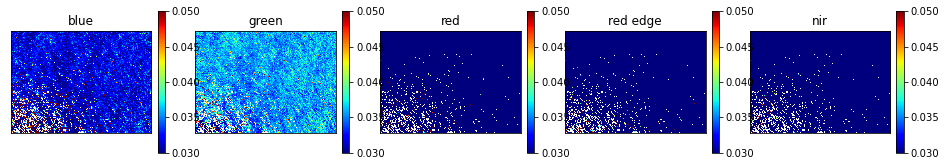

1.9575664032309468


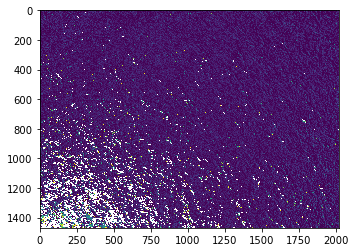

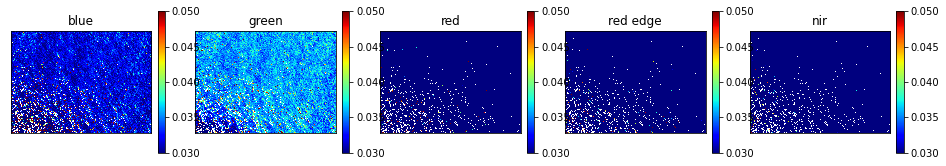

1.9588675456628146


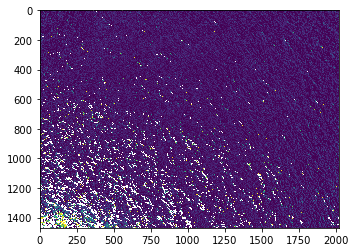

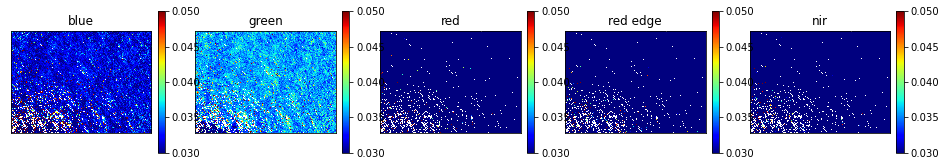

1.9696424872256548


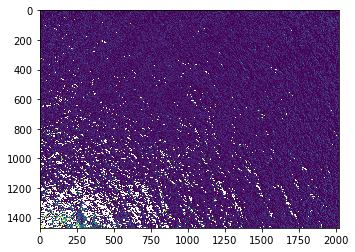

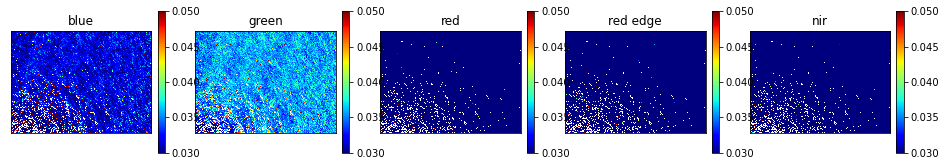

1.9703334039855704


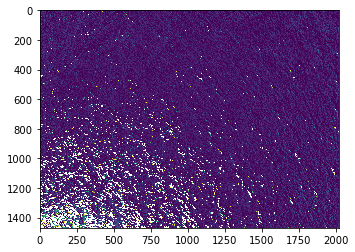

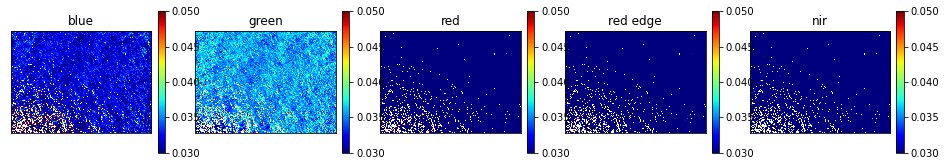

1.9677781029994676


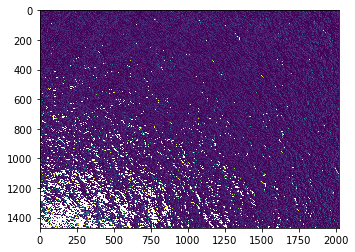

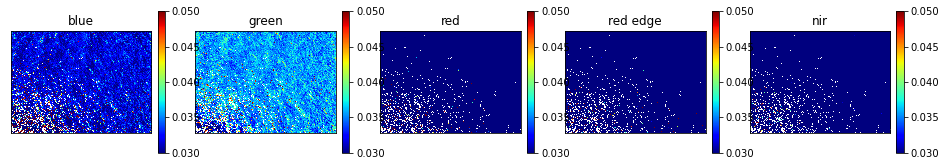

1.9587372288689253


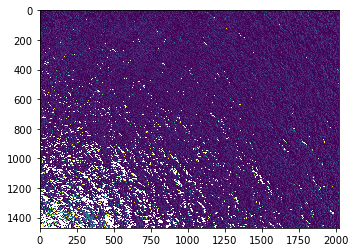

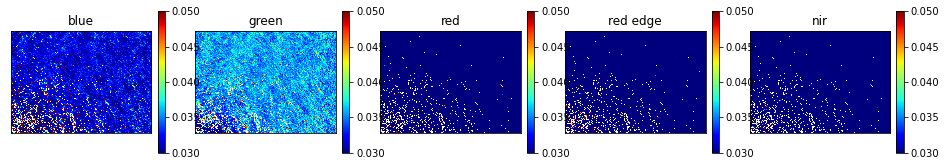

1.9709304141500823


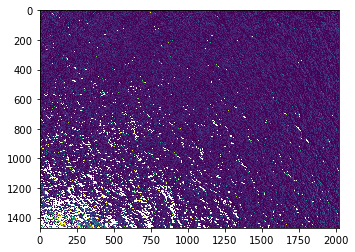

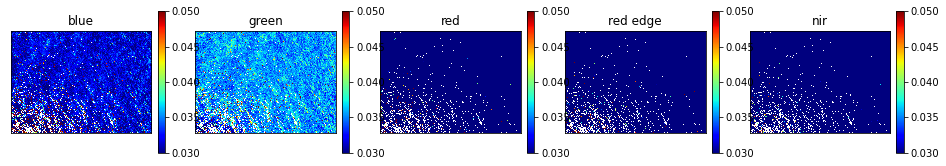

1.9602138489051766


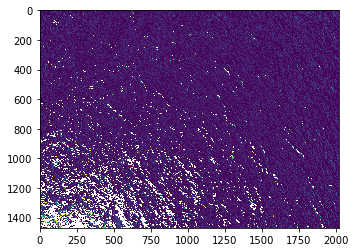

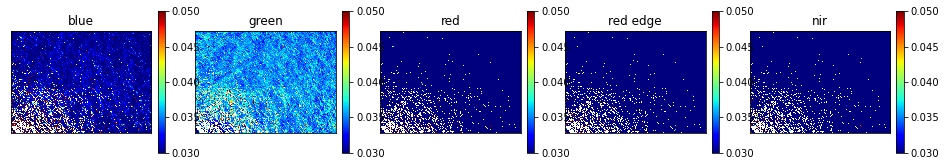

2.133193949977428


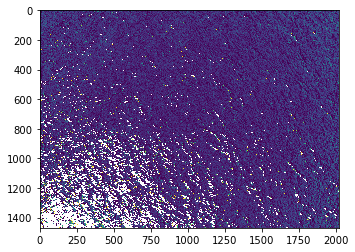

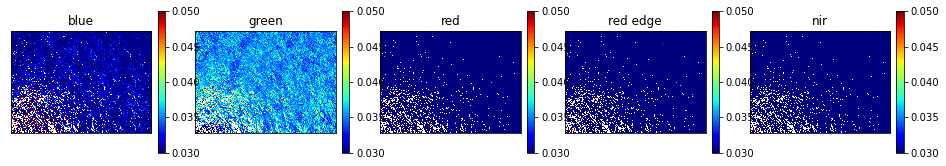

2.1453720471059134
10th image


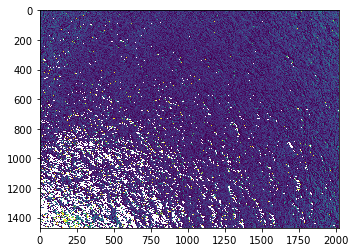

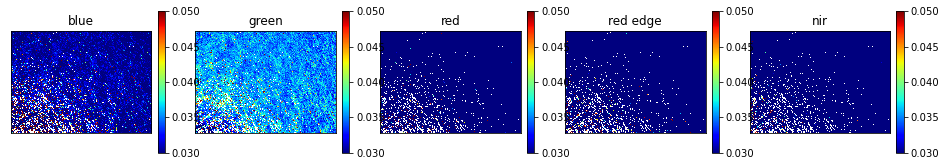

2.131843822784408


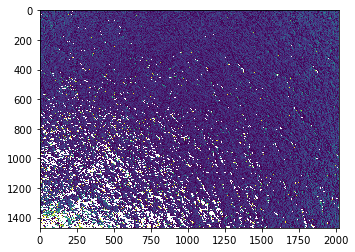

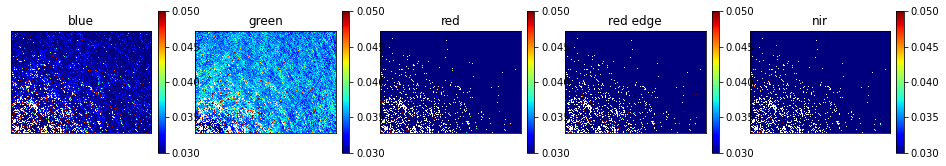

2.1442190262918386


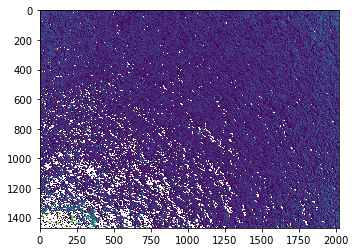

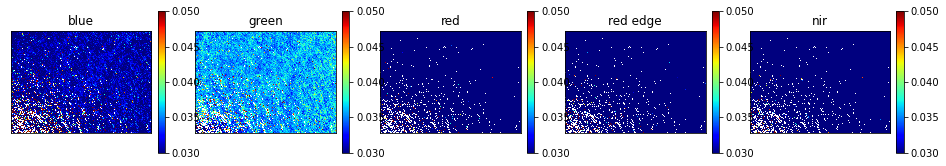

2.1573708782093615


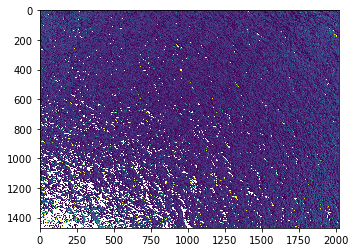

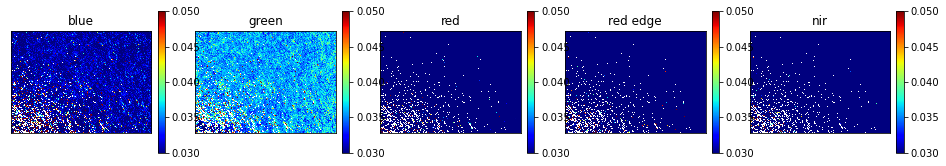

2.1452407721614772


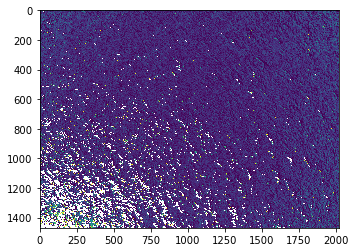

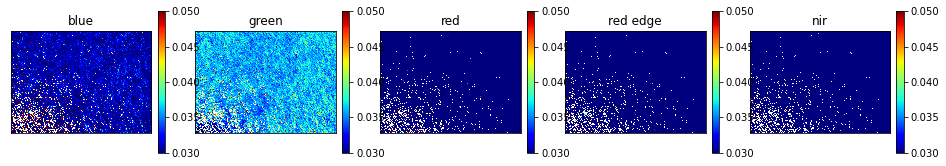

2.1501990876912354


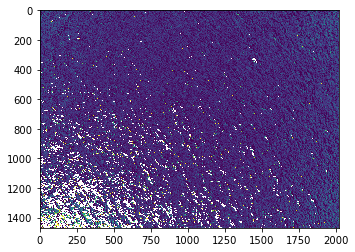

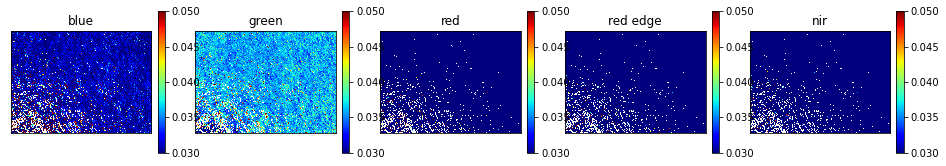

2.1366817273624967


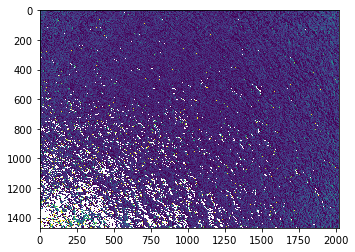

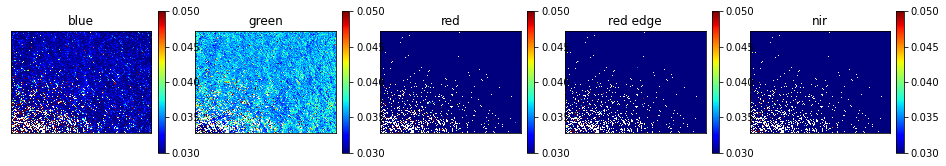

2.136963322082439


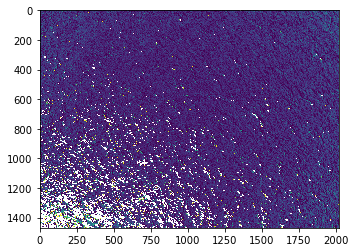

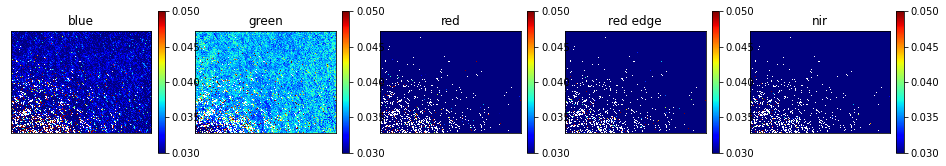

2.147753356625112


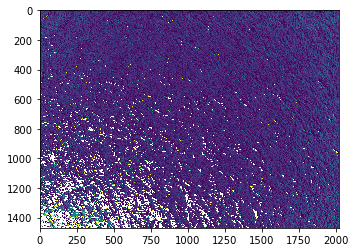

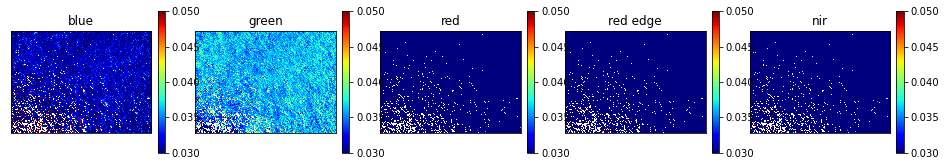

2.1476065519114442


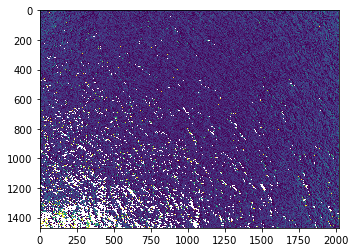

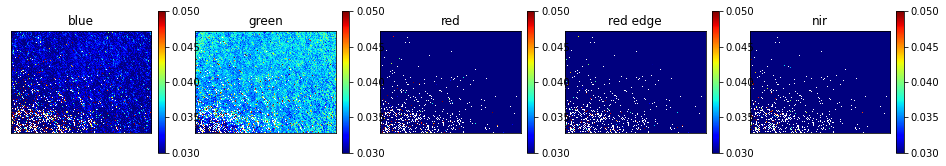

2.142610375112381
10th image


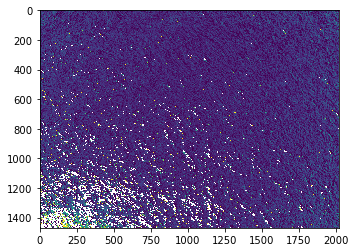

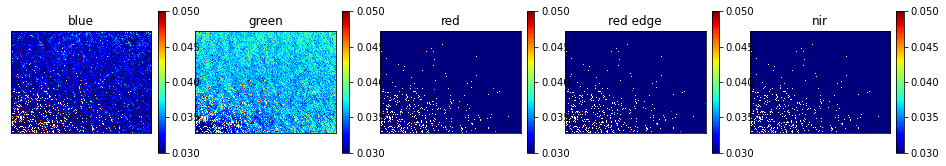

2.138152006474083


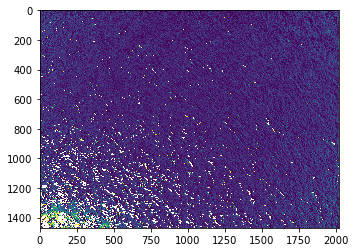

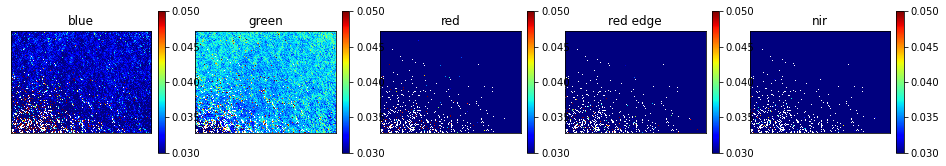

2.1357386385485584


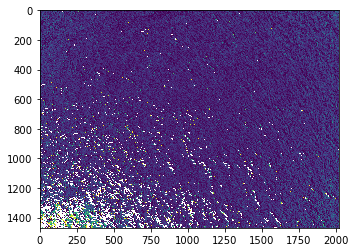

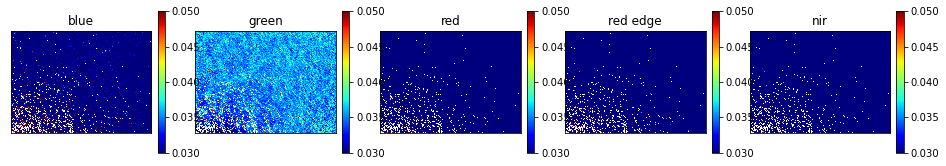

2.585145701168795


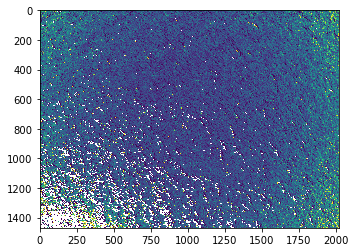

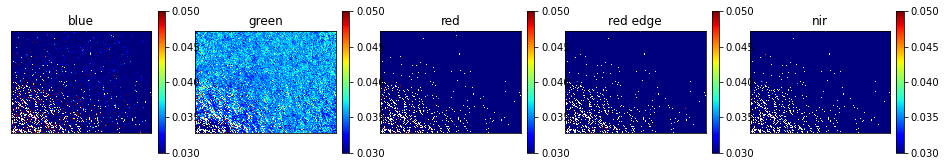

2.583729647725654


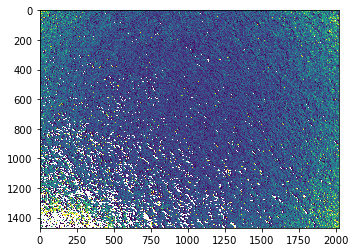

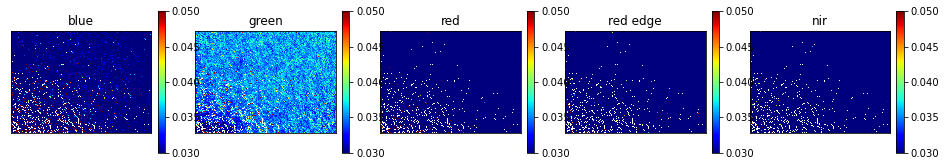

2.5625162275138735


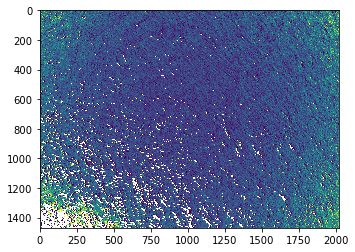

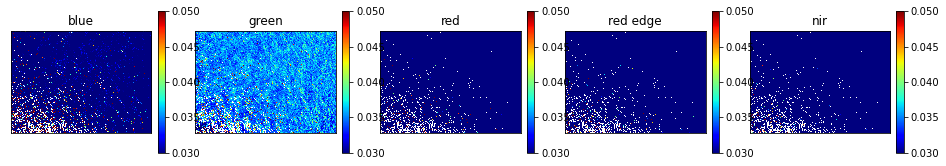

2.569312471213291


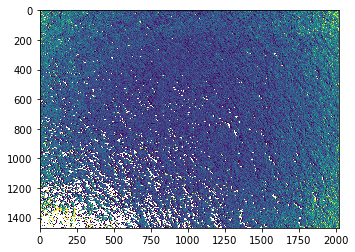

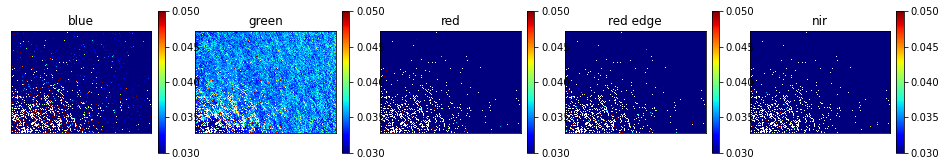

2.5572378823472937


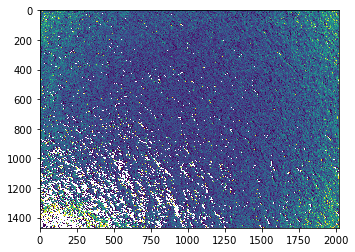

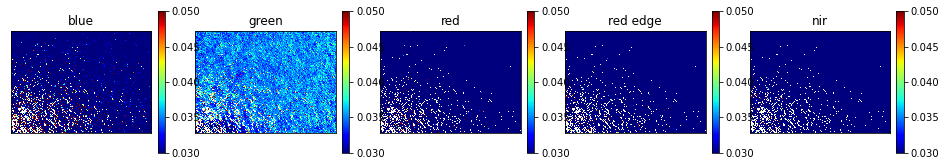

2.5601076622010357


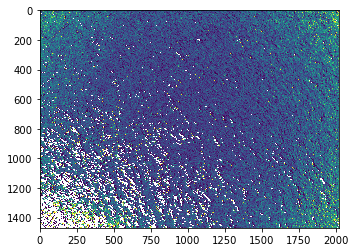

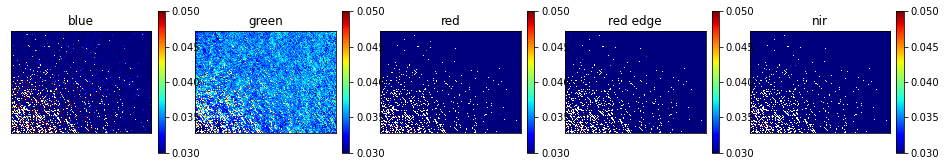

2.560583187059734


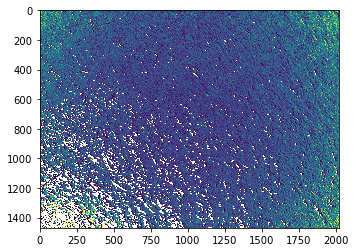

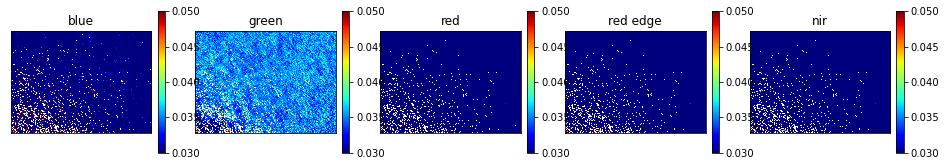

2.5624606466978075
10th image


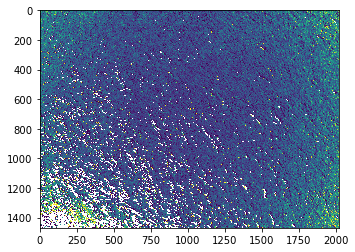

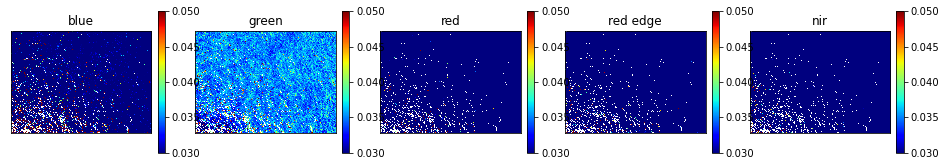

2.584643859876111


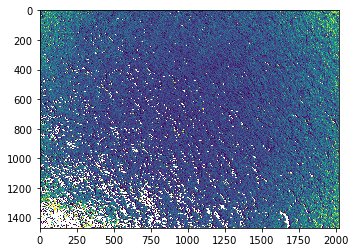

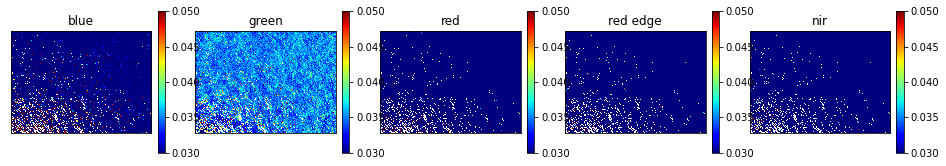

2.5685427271630052


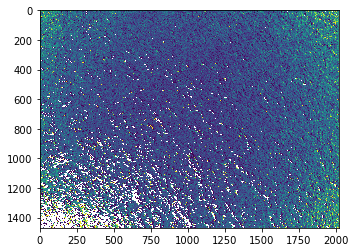

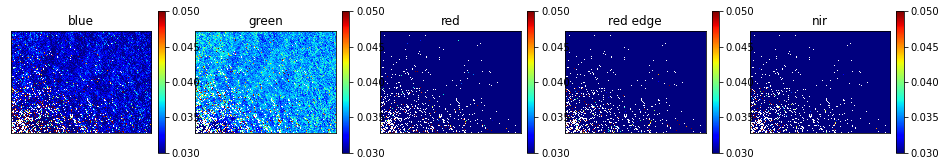

2.0005884172076405


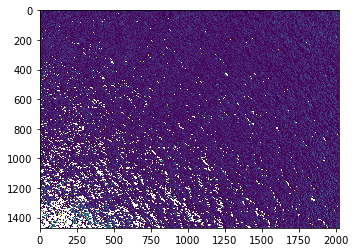

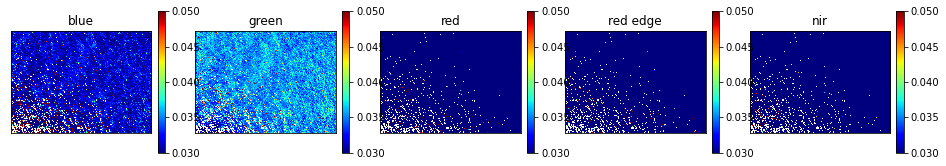

1.9913088961864127


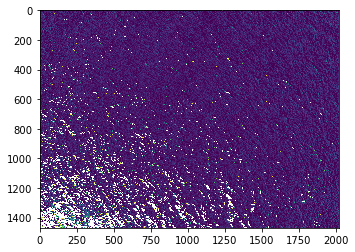

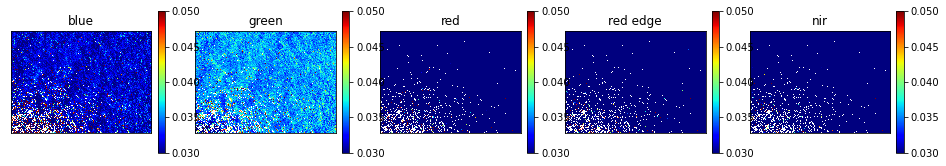

2.0011847692984026


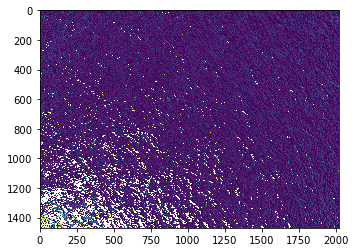

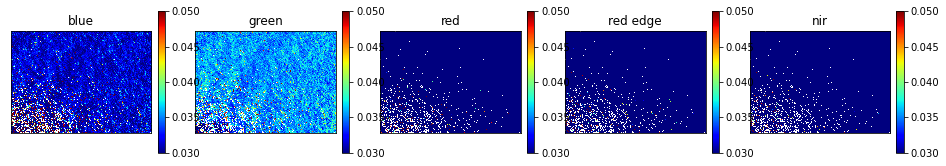

1.9870829493883255


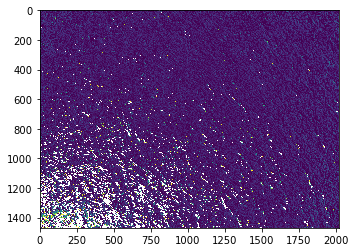

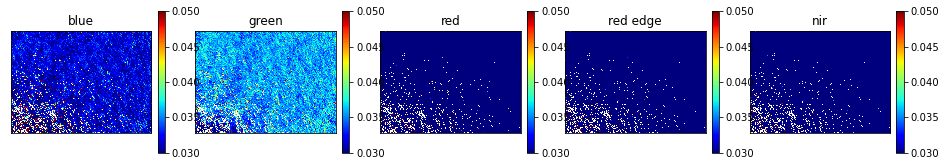

1.9918746210803087


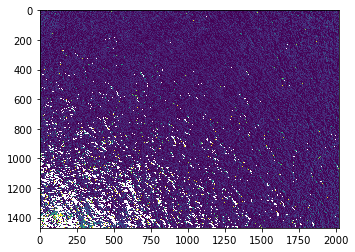

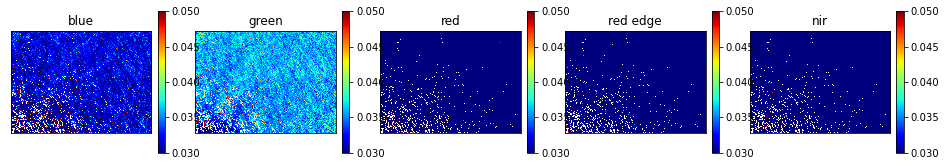

1.9905017113243295


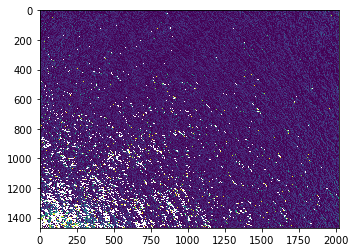

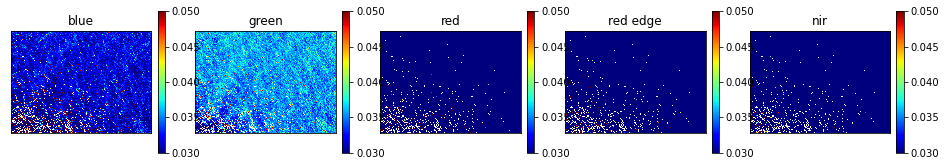

1.9814725053839788


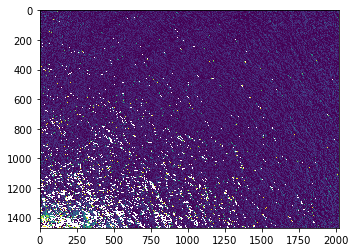

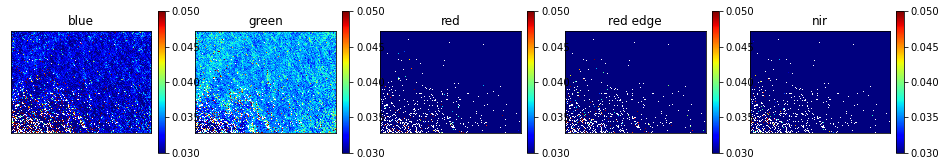

1.9813017562485127
10th image


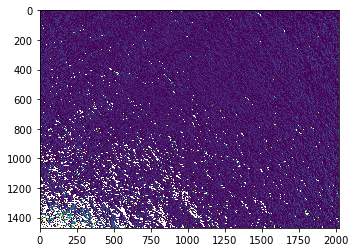

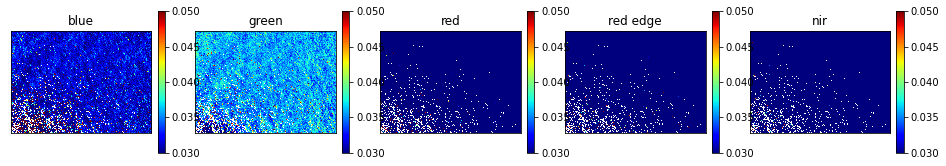

1.9985123710476744


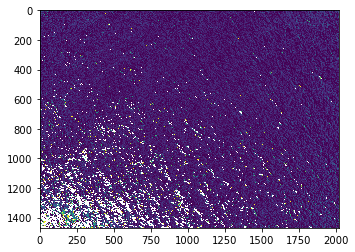

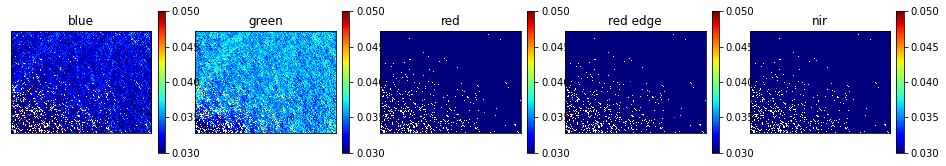

1.989644356745825


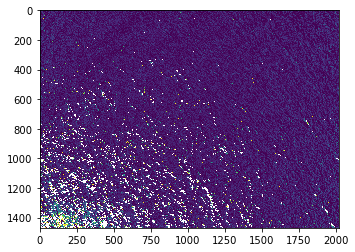

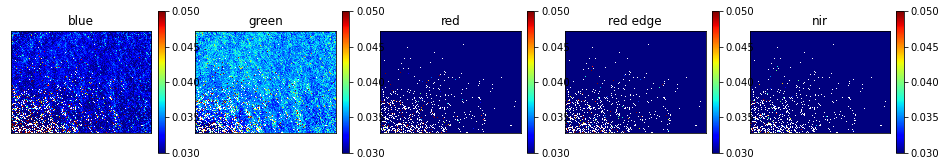

1.953447585297575


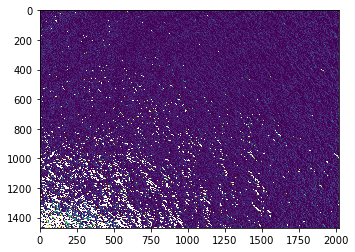

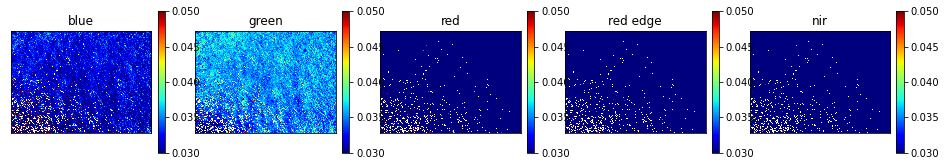

1.953827890987538


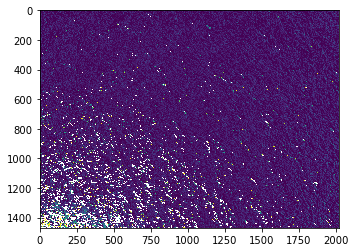

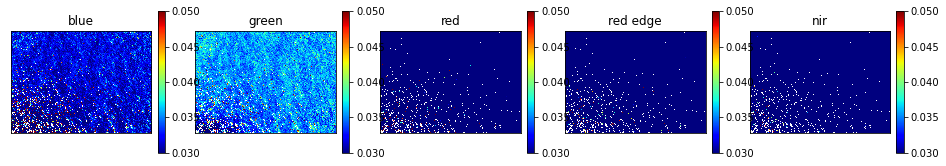

1.9546549145949121


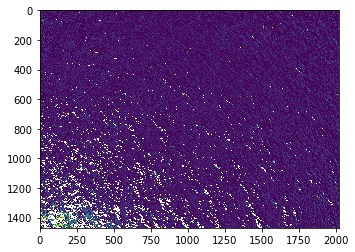

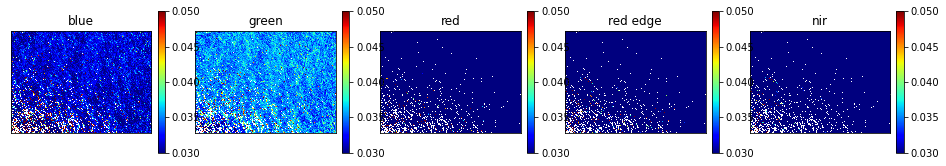

1.955611128780633


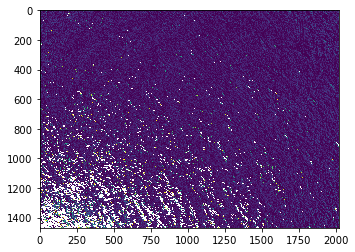

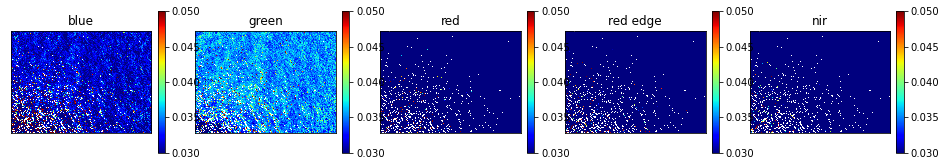

1.9723401999357788


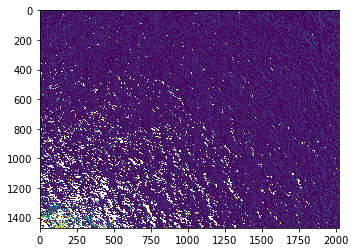

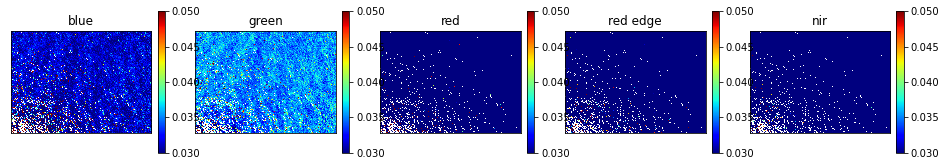

1.975022138929767


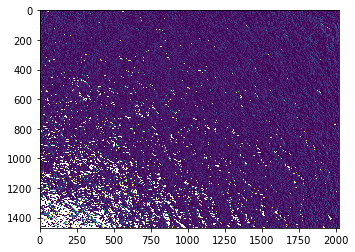

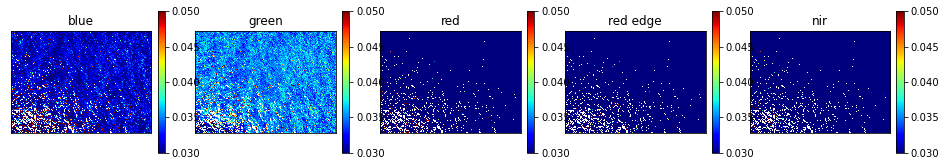

1.9646030924288629


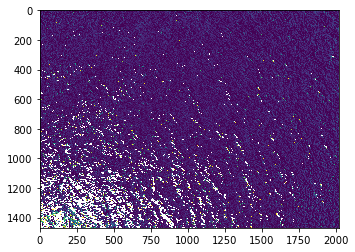

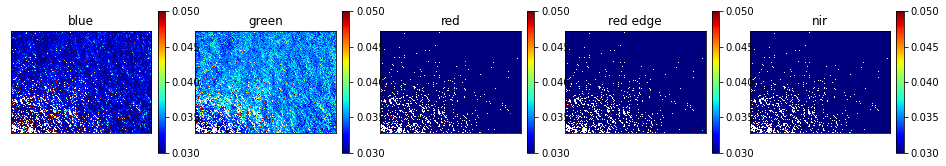

1.960225541326471
10th image


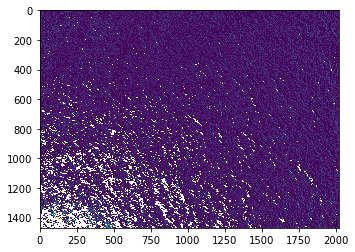

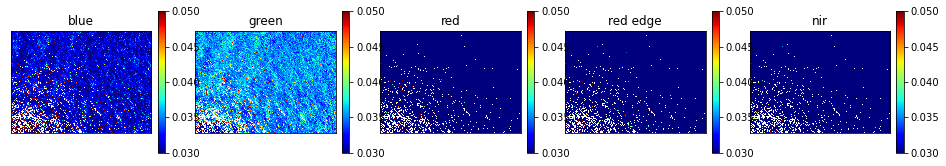

1.970064698839367


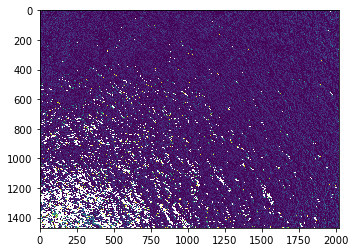

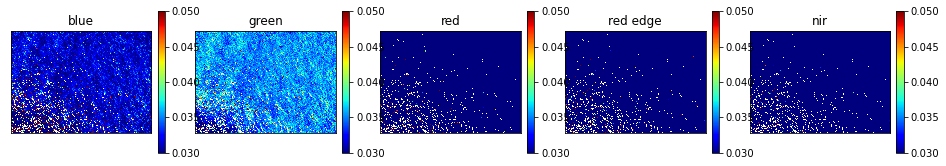

1.9741545309688855


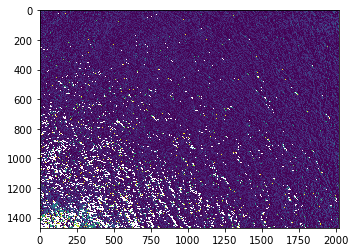

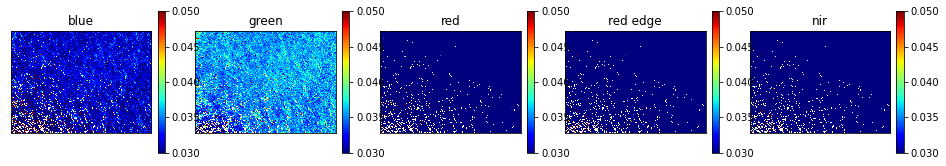

2.010422784616425


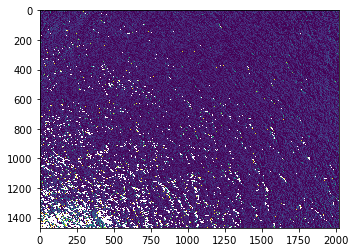

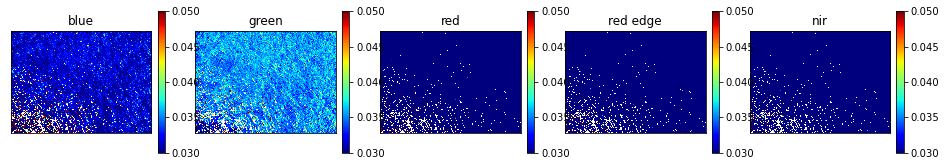

1.9885390150968767


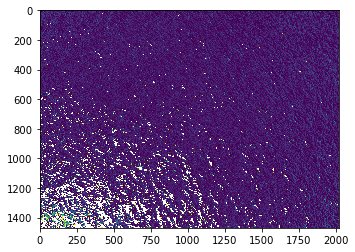

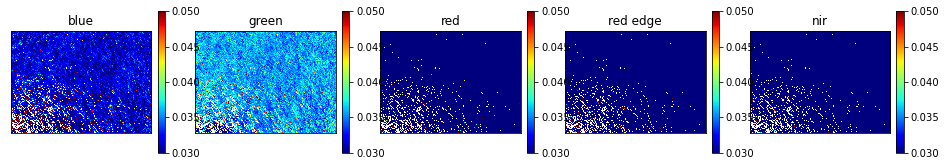

1.9959781420148335


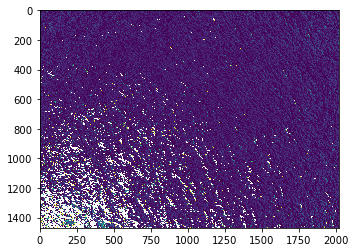

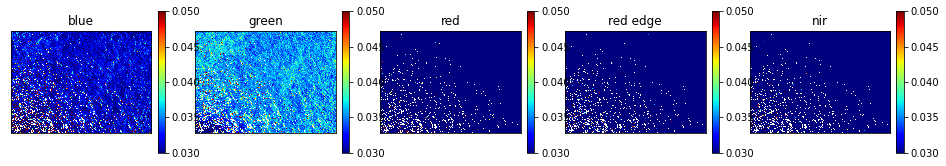

1.9858665391367059


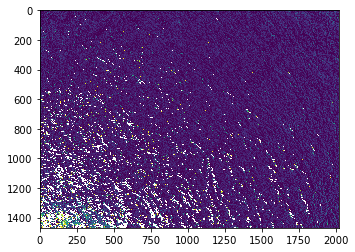

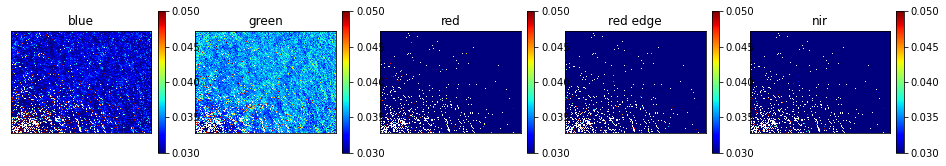

1.9873274082671788


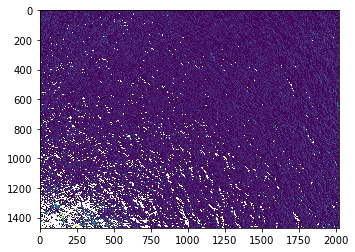

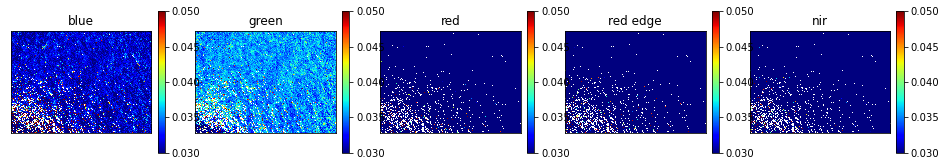

1.987871223844929


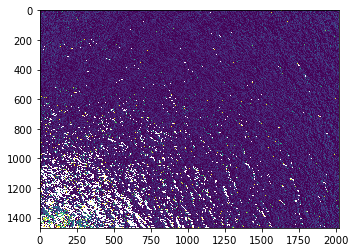

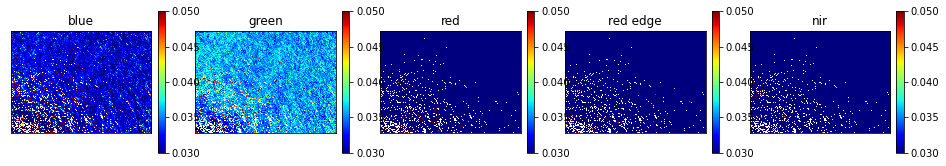

1.9964801229633533


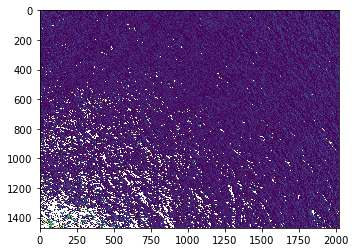

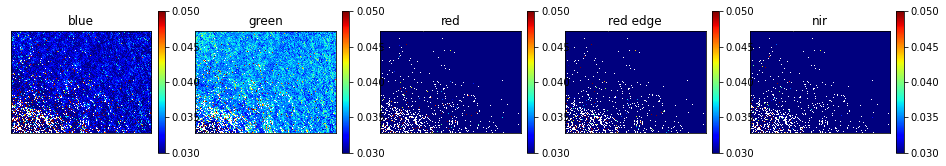

1.9861995589565118
10th image


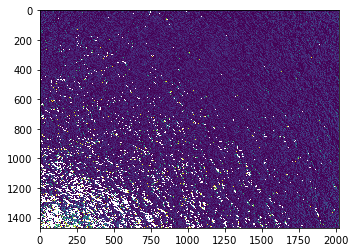

KeyboardInterrupt: 

In [139]:
count = 0
for i in range(51,len(mds)-51-18):
    count +=1
    if count ==10:
        print('10th image')
        count = 0
    img = retrieve_imgs_and_metadata(surface_dir, count=1, start=i, altitude_cutoff=0)[0]
    lw_img = img[0,:5,:,:] - smoothed_lt_lw
    lw_img[np.repeat((lw_img[1] > 0.06)[np.newaxis,:,:],5,axis=0)] = np.nan
    
    visualize_darkest_pixels(lw_img, lowest_percent=1, max_clim=0.050, min_clim=0.03, only_img=True)
    
    
    chla_img = vec_chla_img(lw_img[0], lw_img[1])
    chla_img[chla_img<0] = 0
    chla_img[chla_img>6] = np.nan
    plt.imshow(chla_img, clim=(1.8,5), interpolation='none')
    print(np.nanmedian(chla_img))

In [141]:
lats = []
lons = []
chla_list = []
chla_dates = []
temps = []
count = 0
for i in range(51,len(mds)-51-18):
    count +=1
    if count ==10:
        print('10th image')
        count = 0
    img = retrieve_imgs_and_metadata(surface_dir, count=1, start=i, altitude_cutoff=0)[0]
    
    sst = img[0,5]
    sst_in_k = np.median(sst) * 32768 / 100
#     plt.imshow(sst* 32768 / 100, vmin=288,vmax=292)
#     print(sst_in_k)
#     plt.show()
    
    img = img[0,:5,:,:] - smoothed_lt_lw
    #img = sea_imgs[i,:5].copy() 
    img[np.repeat((img[1] > 0.06)[np.newaxis,:,:],5,axis=0)] = np.nan
    chla_img = vec_chla_img(img[0], img[1])
    chla_img[chla_img<0] = 0
    chla_img[chla_img>6] = np.nan
    chla_med = np.nanmedian(chla_img)
    #img_median = np.nanmedian(img, axis=(1,2))
    #oc_med = oc_index(img_median[0], img_median[1], img_median[2])
    #oc_med = vec_chla_img(img_median[0], img_median[1])

    chla_list.append(chla_med)
    lats.append(mds[i]['Latitude'])
    lons.append(mds[i]['Longitude'])
    chla_dates.append(datetime.datetime.strptime(mds[i]['Date']+' - '+mds[i]['UTC-Time'], '%m/%d/%Y - %H:%M:%S'))
    temps.append(sst_in_k)

10th image
10th image
10th image
10th image
10th image
10th image
10th image
10th image
10th image
10th image
10th image
10th image
10th image
10th image
10th image
10th image
10th image
10th image
10th image
10th image
10th image
10th image
10th image
10th image
10th image
10th image
10th image
10th image
10th image
10th image
10th image
10th image
10th image
10th image
10th image


In [151]:
len(chla_list)

359

<AxesSubplot:>

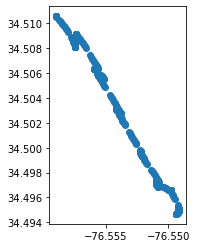

In [152]:
import geopandas as gpd
chla_df = pd.DataFrame(
    {'chla': chla_list,
     'Latitude': lats,
     'Longitude': lons,
     'time' : chla_dates,
     'sst' : temps
    })

chla_gdf = gpd.GeoDataFrame(
    chla_df, geometry=gpd.points_from_xy(chla_df.Longitude, chla_df.Latitude))
chla_gdf.plot()

<AxesSubplot:>

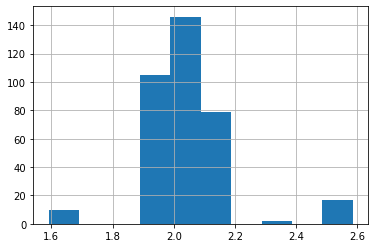

In [153]:
chla_gdf['chla'].hist()

<AxesSubplot:>

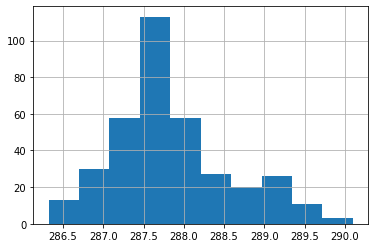

In [154]:
chla_gdf['sst'].hist()

<AxesSubplot:>

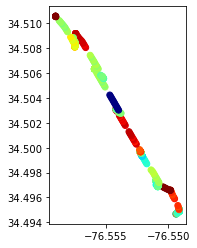

In [155]:
chla_gdf.plot(column=chla_gdf['chla'],vmin=1.8, vmax=2.2, cmap='jet')

<AxesSubplot:>

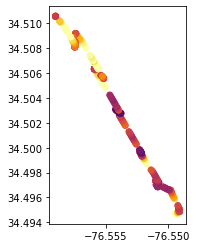

In [156]:
chla_gdf.plot(column=chla_gdf['sst'],vmin=286, vmax=289, cmap='inferno')

In [157]:
chla_gdf['time_str'] = chla_gdf['time'].astype(str)

In [158]:
chla_gdf.drop('time', 1).to_file('chla_sst_flight4.shp')

### Write out the data as .tifs

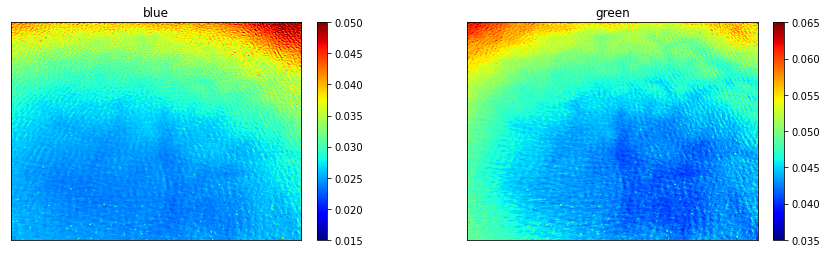

/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3427: FutureWarning: Indexing a timezone-naive DatetimeIndex with a timezone-aware datetime is deprecated and will raise KeyError in a future version.  Use a timezone-naive object instead.
  exec(code_obj, self.user_global_ns, self.user_ns)


34.7138816 -76.6757056 47.83 -74.5 0 40
0.05
img coords:  [[ 258.3914646  2348.50889259]
 [ 686.43797456  805.02304135]
 [1762.20844904 1473.83633639]
 [1525.06358628 2328.95308621]]
initial profile
{'driver': 'GTiff', 'dtype': 'uint16', 'nodata': None, 'width': 2064, 'height': 1544, 'count': 1, 'crs': None, 'transform': Affine(1.0, 0.0, 0.0,
       0.0, 1.0, 0.0), 'tiled': False, 'interleave': 'band'}
updated profile
{'driver': 'GTiff', 'dtype': 'float32', 'nodata': None, 'width': 4000, 'height': 4000, 'count': 1, 'crs': 'EPSG:4326', 'transform': Affine(3.5185429974500584e-12, 5.470247326852344e-07, -76.6767996560071,
       -4.4965761414818946e-07, 2.387899005108411e-12, 34.7147809111126), 'tiled': False, 'interleave': 'band'}
written out as  blue_georeg_finerLKLBZ1Ww6EphUE56L9ZR.tif
Complete!


/home/clifgray/Code/ocean_color/georeg.py:66: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.
  
/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/rasterio/__init__.py:218: NotGeoreferencedWarning: Dataset has no geotransform set. The identity matrix may be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)
/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3427: FutureWarning: Indexing a timezone-naive DatetimeIndex with a timezone-aware datetime is deprecated and will raise KeyError in a future version.  Use a timezone-naive object instead.
  exec(code_obj, self.user_global_ns, self.user_ns)


34.7138816 -76.6757056 47.83 -74.5 0 40
0.05
img coords:  [[ 258.3914646  2348.50889259]
 [ 686.43797456  805.02304135]
 [1762.20844904 1473.83633639]
 [1525.06358628 2328.95308621]]
initial profile
{'driver': 'GTiff', 'dtype': 'uint16', 'nodata': None, 'width': 2064, 'height': 1544, 'count': 1, 'crs': None, 'transform': Affine(1.0, 0.0, 0.0,
       0.0, 1.0, 0.0), 'tiled': False, 'interleave': 'band'}
updated profile
{'driver': 'GTiff', 'dtype': 'float32', 'nodata': None, 'width': 4000, 'height': 4000, 'count': 1, 'crs': 'EPSG:4326', 'transform': Affine(3.5185429974500584e-12, 5.470247326852344e-07, -76.6767996560071,
       -4.4965761414818946e-07, 2.387899005108411e-12, 34.7147809111126), 'tiled': False, 'interleave': 'band'}
written out as  green_georeg_finerLKLBZ1Ww6EphUE56L9ZR.tif
Complete!


/home/clifgray/Code/ocean_color/georeg.py:66: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.
  
/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/rasterio/__init__.py:218: NotGeoreferencedWarning: Dataset has no geotransform set. The identity matrix may be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


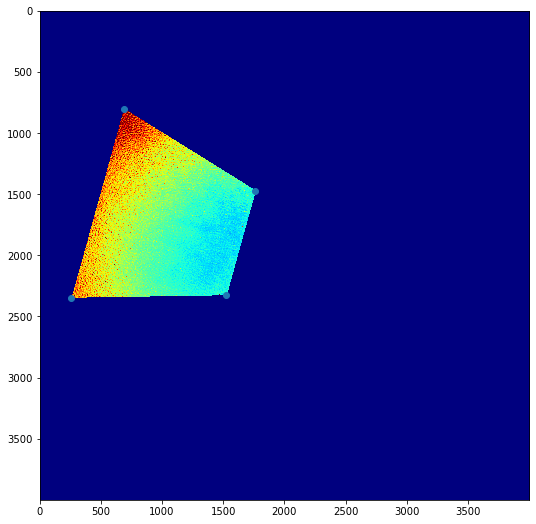

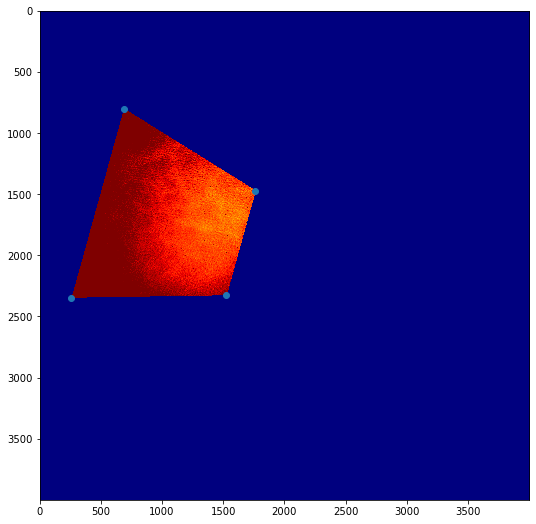

In [59]:
from skimage.transform import resize

for i in range(15):
    
    # form is [x_min, x_max, y_min, y_max]
    top_im_bounds=[-100,100,-100,100]
    
    original_img = plt.imread(sea_img_metadata[i]['image_name'])
    resized_blue = resize(sea_imgs[i,0], (original_img.shape[0], original_img.shape[1]), anti_aliasing=True)
    resized_green = resize(sea_imgs[i,1], (original_img.shape[0], original_img.shape[1]), anti_aliasing=True)
    
    resized_blue[resized_blue < 0] = 0
    resized_green[resized_green < 0] = 0
    
    fig, ax = plt.subplots(1,2, figsize=(15,4))
    im = ax[0].imshow(resized_blue,cmap='jet', vmin=0.015, vmax=.05)
    fig.colorbar(im, ax=ax[0], fraction=0.046, pad=0.04)
    ax[0].set_xticks([])
    ax[0].set_yticks([])
    ax[0].set_title('blue')
    
    im = ax[1].imshow(resized_green,cmap='jet', vmin=0.035, vmax=.065)
    fig.colorbar(im, ax=ax[1], fraction=0.046, pad=0.04)
    ax[1].set_xticks([])
    ax[1].set_yticks([])
    ax[1].set_title('green')
    plt.show()
    new_name = 'blue_georeg_finer' + sea_img_metadata[i]['filename']
    alta_micasense_georef(sea_img_metadata[i]['image_name'], new_name, resized_blue, alta_logs, top_im_bounds=top_im_bounds, scaling=0.05)
    new_name = 'green_georeg_finer' + sea_img_metadata[i]['filename']
    alta_micasense_georef(sea_img_metadata[i]['image_name'], new_name, resized_green, alta_logs, top_im_bounds=top_im_bounds, scaling=0.05)
    
    break

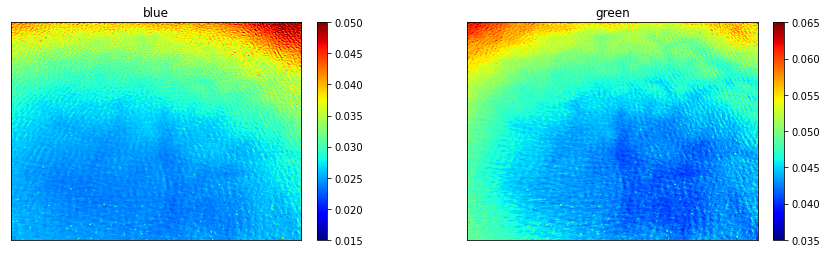

/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3427: FutureWarning: Indexing a timezone-naive DatetimeIndex with a timezone-aware datetime is deprecated and will raise KeyError in a future version.  Use a timezone-naive object instead.
  exec(code_obj, self.user_global_ns, self.user_ns)


34.7138816 -76.6757056 47.83 -74.5 0 40
0.05
img coords:  [[-441.6085354  1548.50889259]
 [ -13.56202544    5.02304135]
 [1062.20844904  673.83633639]
 [ 825.06358628 1528.95308621]]
initial profile
{'driver': 'GTiff', 'dtype': 'uint16', 'nodata': None, 'width': 2064, 'height': 1544, 'count': 1, 'crs': None, 'transform': Affine(1.0, 0.0, 0.0,
       0.0, 1.0, 0.0), 'tiled': False, 'interleave': 'band'}
updated profile
{'driver': 'GTiff', 'dtype': 'float32', 'nodata': None, 'width': 2600, 'height': 2400, 'count': 1, 'crs': 'EPSG:4326', 'transform': Affine(3.5185429974500584e-12, 5.470247326852344e-07, -76.67641673587939,
       -4.4965761414818946e-07, 2.387899005108411e-12, 34.7144211866928), 'tiled': False, 'interleave': 'band'}
written out as  blue_georeg_finerLKLBZ1Ww6EphUE56L9ZR.tif
Complete!
34.7138816 -76.6757056 47.83 -74.5 0 40
0.05


/home/clifgray/Code/ocean_color/georeg.py:66: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.
  
/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/rasterio/__init__.py:218: NotGeoreferencedWarning: Dataset has no geotransform set. The identity matrix may be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)
/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3427: FutureWarning: Indexing a timezone-naive DatetimeIndex with a timezone-aware datetime is deprecated and will raise KeyError in a future version.  Use a timezone-naive object instead.
  exec(code_obj, self.user_global_ns, self.user_ns)


img coords:  [[-441.6085354  1548.50889259]
 [ -13.56202544    5.02304135]
 [1062.20844904  673.83633639]
 [ 825.06358628 1528.95308621]]
initial profile
{'driver': 'GTiff', 'dtype': 'uint16', 'nodata': None, 'width': 2064, 'height': 1544, 'count': 1, 'crs': None, 'transform': Affine(1.0, 0.0, 0.0,
       0.0, 1.0, 0.0), 'tiled': False, 'interleave': 'band'}
updated profile
{'driver': 'GTiff', 'dtype': 'float32', 'nodata': None, 'width': 2600, 'height': 2400, 'count': 1, 'crs': 'EPSG:4326', 'transform': Affine(3.5185429974500584e-12, 5.470247326852344e-07, -76.67641673587939,
       -4.4965761414818946e-07, 2.387899005108411e-12, 34.7144211866928), 'tiled': False, 'interleave': 'band'}
written out as  green_georeg_finerLKLBZ1Ww6EphUE56L9ZR.tif
Complete!


/home/clifgray/Code/ocean_color/georeg.py:66: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.
  
/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/rasterio/__init__.py:218: NotGeoreferencedWarning: Dataset has no geotransform set. The identity matrix may be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


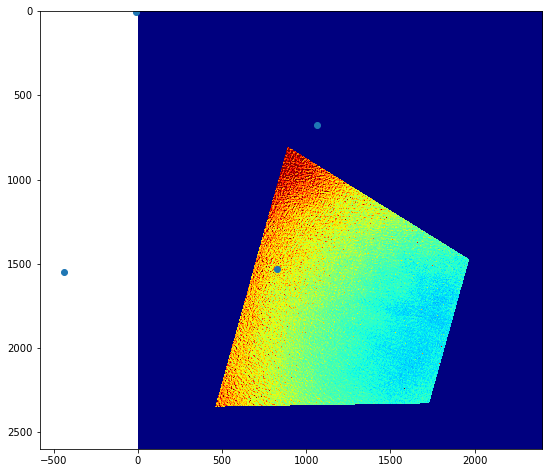

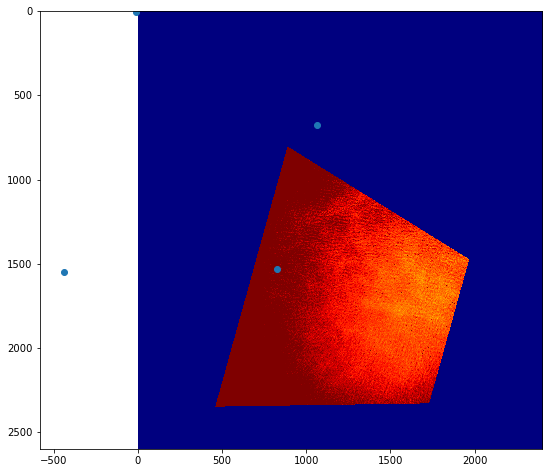

In [58]:
from skimage.transform import resize

for i in range(15):
    
    # form is [x_min, x_max, y_min, y_max]
    top_im_bounds=[-110,10,-30,100]
    x_center_offset = 10 - 110 / 0.05
    
    original_img = plt.imread(sea_img_metadata[i]['image_name'])
    resized_blue = resize(sea_imgs[i,0], (original_img.shape[0], original_img.shape[1]), anti_aliasing=True)
    resized_green = resize(sea_imgs[i,1], (original_img.shape[0], original_img.shape[1]), anti_aliasing=True)
    
    fig, ax = plt.subplots(1,2, figsize=(15,4))
    im = ax[0].imshow(resized_blue,cmap='jet', vmin=0.015, vmax=.05)
    fig.colorbar(im, ax=ax[0], fraction=0.046, pad=0.04)
    ax[0].set_xticks([])
    ax[0].set_yticks([])
    ax[0].set_title('blue')
    
    im = ax[1].imshow(resized_green,cmap='jet', vmin=0.035, vmax=.065)
    fig.colorbar(im, ax=ax[1], fraction=0.046, pad=0.04)
    ax[1].set_xticks([])
    ax[1].set_yticks([])
    ax[1].set_title('green')
    plt.show()
    new_name = 'blue_georeg_finer' + sea_img_metadata[i]['filename']
    alta_micasense_georef(sea_img_metadata[i]['image_name'], new_name, resized_blue, alta_logs, top_im_bounds=top_im_bounds, scaling=0.05)
    new_name = 'green_georeg_finer' + sea_img_metadata[i]['filename']
    alta_micasense_georef(sea_img_metadata[i]['image_name'], new_name, resized_green, alta_logs, top_im_bounds=top_im_bounds, scaling=0.05)
    
    break